In [1]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from pathlib import Path
import numpy as np
import os
import sys
import glob
#import pandas as pd
import xml.etree.ElementTree as et
import datetime
from skimage.io import imread, imsave
from imageio import volread as imread

import tifffile
from skimage.filters import threshold_otsu

from tqdm.notebook import tqdm

#import seaborn as sns
import pylab as pl

import numpy as np
import matplotlib.pyplot as plt
from cellpose import plot, utils

In [2]:
# F1 Scores

def f1_score(test, label):
    tp = np.count_nonzero(np.logical_and(test, label))
    fp = np.count_nonzero(np.logical_and(test == True, label == False))
    fn = np.count_nonzero(np.logical_and(test == False, label == True))
    
    score = tp / (tp + 0.5*(fp+fn))
    return score

# Max

# 167 Soma

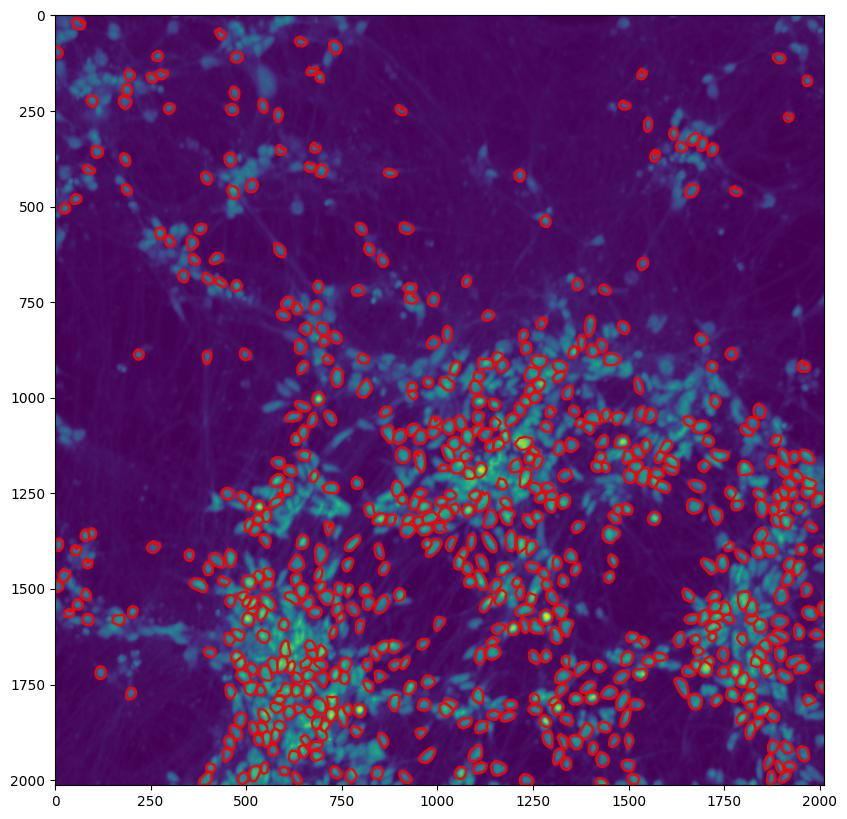

In [30]:
dat_167 = np.load('102522_D21_Coverslip8/crowded/test_Soma/F167_max_seg.npy', allow_pickle=True).item()

# plot image with masks overlaid
mask_RGB = plot.mask_overlay(dat_167['img'], dat_167['masks'],
                        colors=np.array(dat_167['colors']))

# plot image with outlines overlaid in red
outlines = utils.outlines_list(dat_167['masks'])
plt.figure(figsize = (10,10))
plt.imshow(dat_167['img'])
for o in outlines:
    plt.plot(o[:,0], o[:,1], color='r')

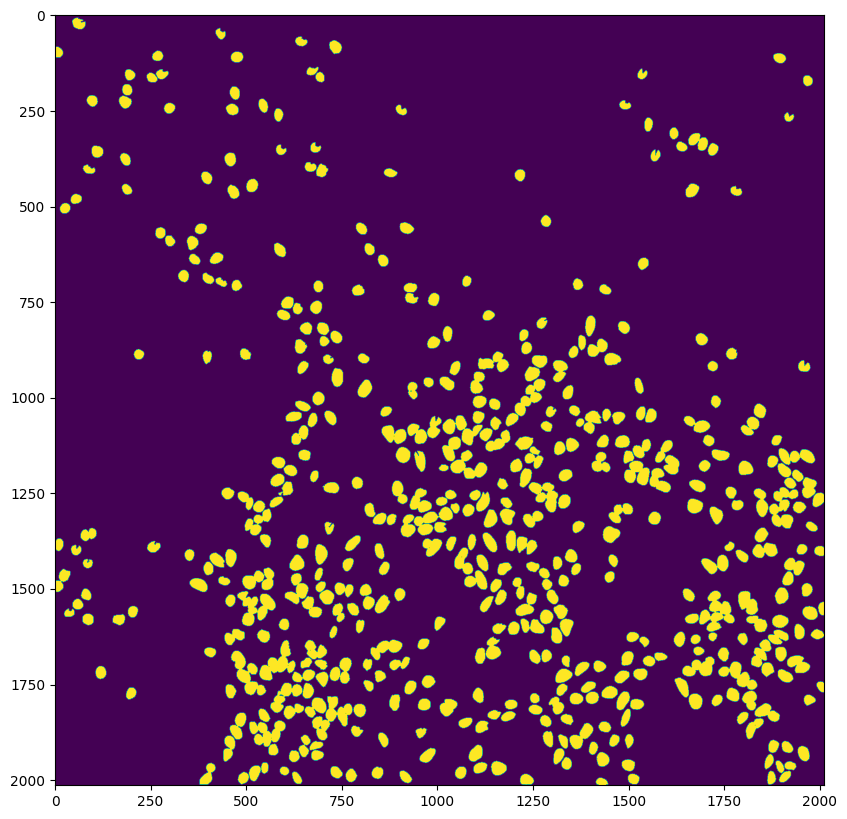

In [31]:
# This is just for calculating the F1 scores
mask_test_167 = dat_167['masks'] > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_test_167)

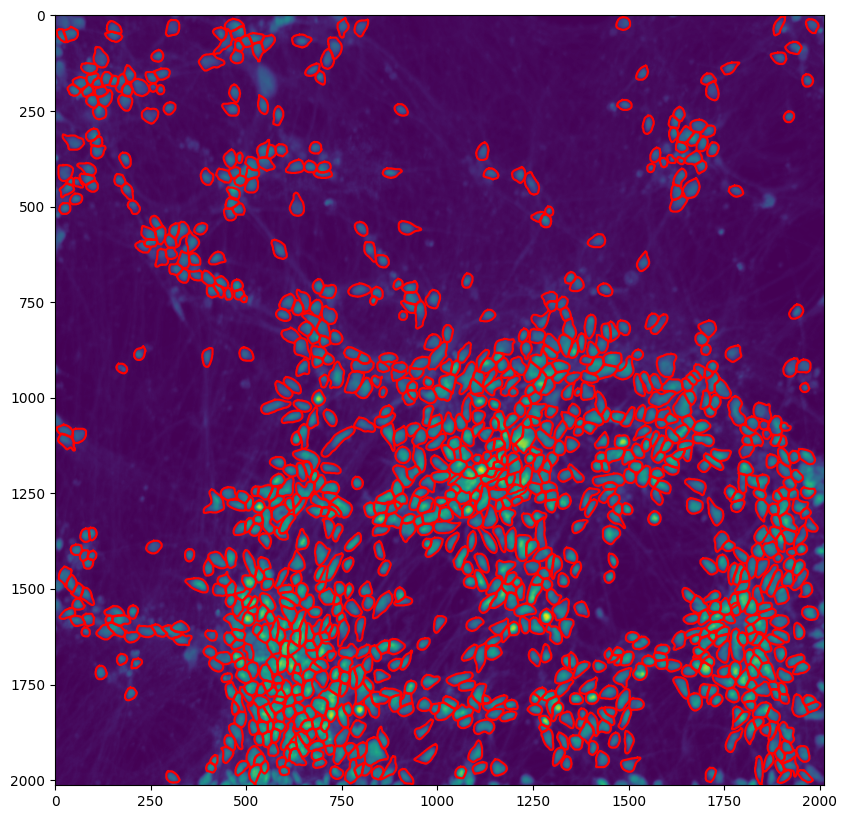

In [51]:
# Looking at Labels now

dat_lab_167 = np.load('102522_D21_Coverslip8/crowded/label_Soma/F167_max_seg.npy', allow_pickle=True).item()

# plot image with masks overlaid
mask_RGB = plot.mask_overlay(dat_lab_167['img'], dat_lab_167['masks'],
                        colors=np.array(dat_lab_167['colors']))

# plot image with outlines overlaid in red
outlines = utils.outlines_list(dat_lab_167['masks'])
plt.figure(figsize = (10,10))
plt.imshow(dat_lab_167['img'])
for o in outlines:
    plt.plot(o[:,0], o[:,1], color='r')

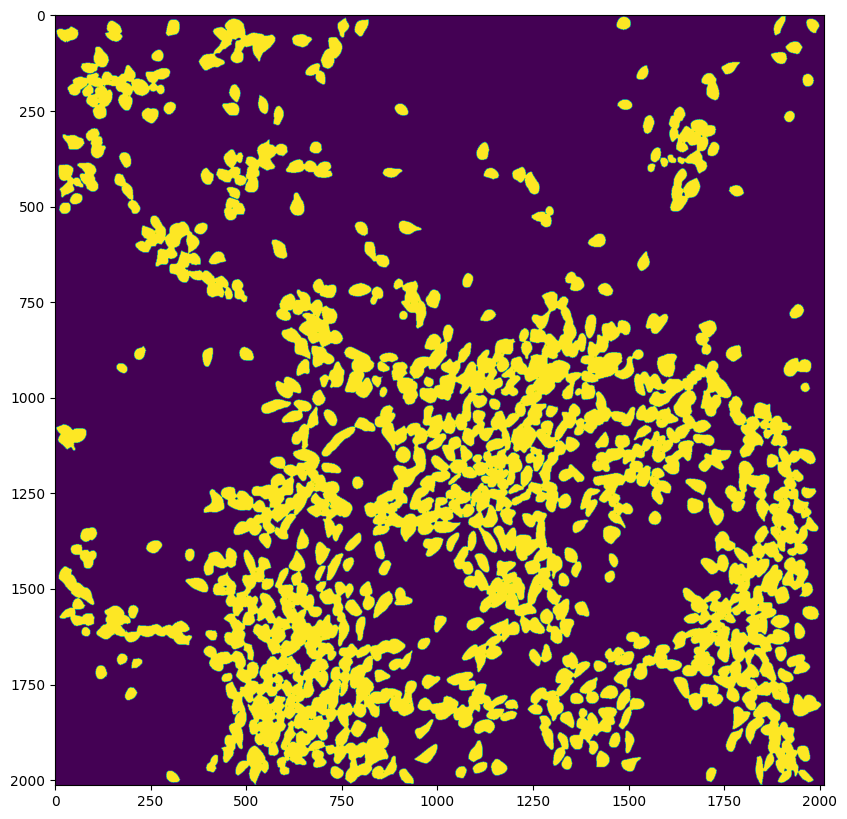

In [46]:
# Labeled mask
mask_lab_167 = dat_lab_167['masks'] > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_lab_167)

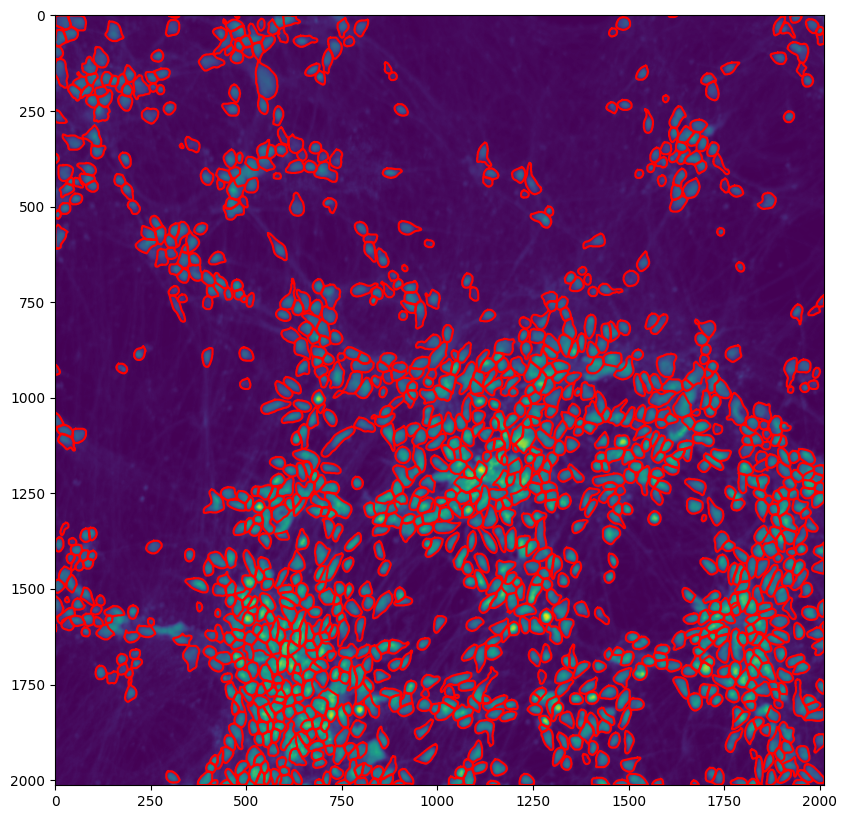

In [35]:
# Pretrained segmentation mask

dat_cyto_167 = np.load('102522_D21_Coverslip8/crowded/Cellpose_Pretrained_cyto/F167_max_seg.npy', allow_pickle=True).item()

# plot image with masks overlaid
mask_RGB = plot.mask_overlay(dat_cyto_167['img'], dat_cyto_167['masks'],
                        colors=np.array(dat_cyto_167['colors']))

# plot image with outlines overlaid in red
outlines = utils.outlines_list(dat_cyto_167['masks'])
plt.figure(figsize = (10,10))
plt.imshow(dat_cyto_167['img'])
for o in outlines:
    plt.plot(o[:,0], o[:,1], color='r')


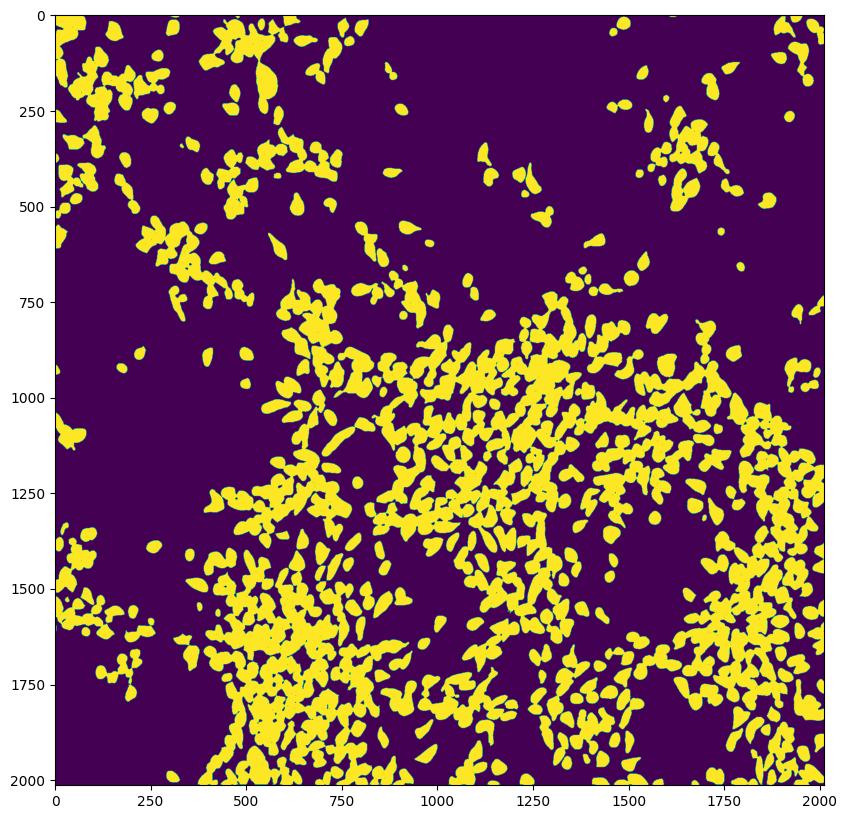

In [36]:
# cyto mask
mask_cyto_167 = dat_cyto_167['masks'] > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_cyto_167)

In [47]:
print(f1_score(mask_test_167, mask_lab_167) ,f1_score(mask_cyto_167, mask_lab_167) )

0.60209169338578 0.9150778615690698


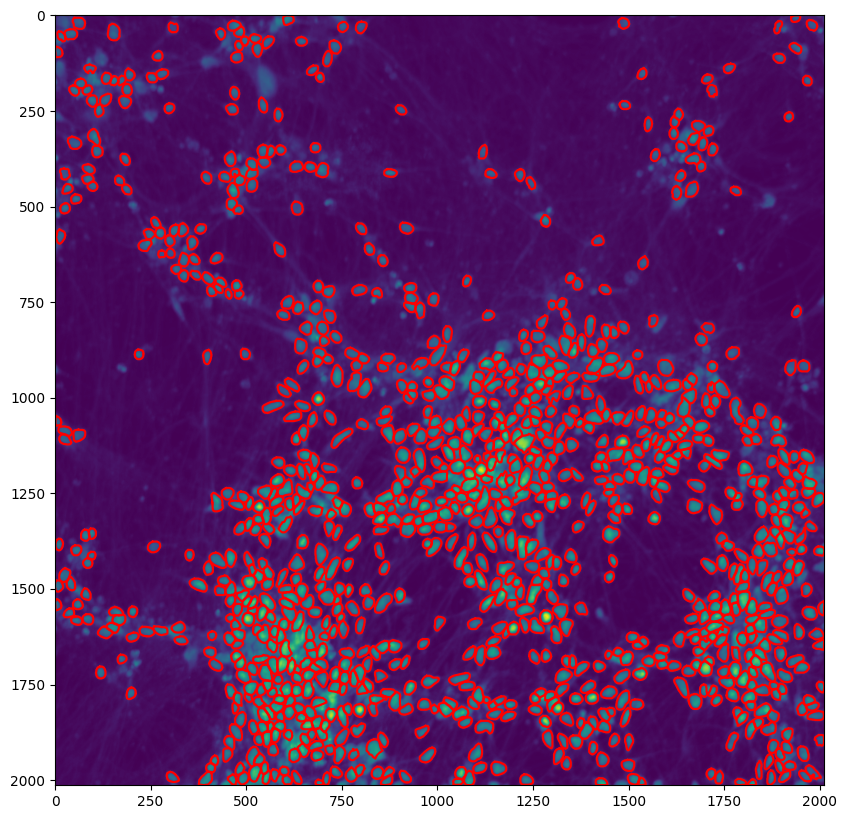

In [38]:
# version 0

dat_v0_167 = np.load('102522_D21_Coverslip8/crowded/Soma_version_0/F167_max_seg.npy', allow_pickle=True).item()

# plot image with masks overlaid
mask_RGB = plot.mask_overlay(dat_v0_167['img'], dat_v0_167['masks'],
                        colors=np.array(dat_v0_167['colors']))

# plot image with outlines overlaid in red
outlines = utils.outlines_list(dat_v0_167['masks'])
plt.figure(figsize = (10,10))
plt.imshow(dat_v0_167['img'])
for o in outlines:
    plt.plot(o[:,0], o[:,1], color='r')


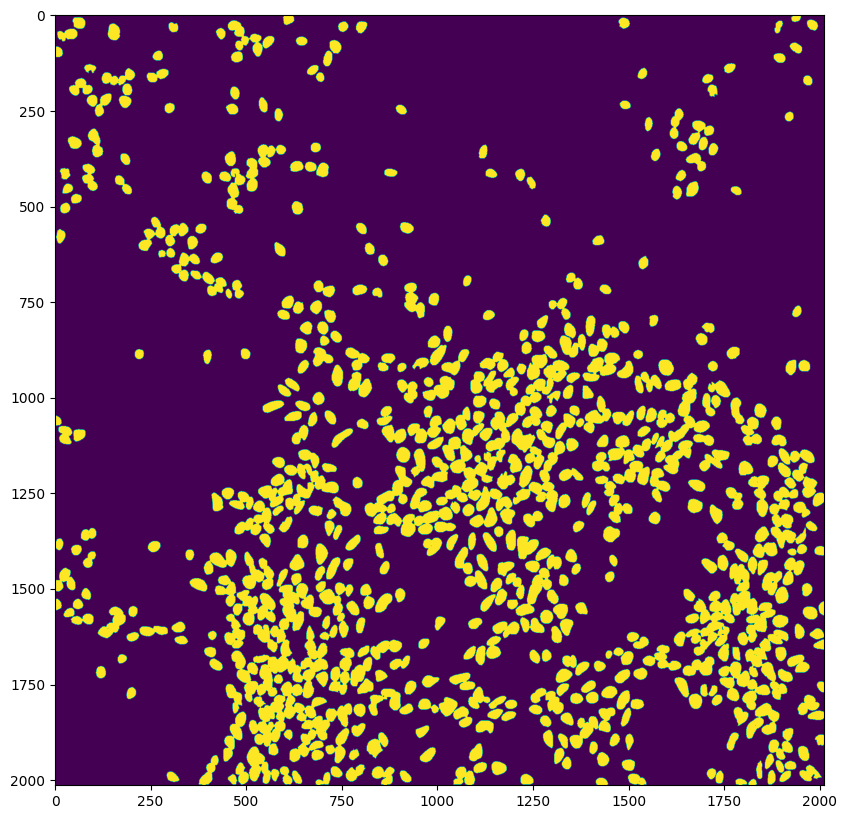

In [39]:
# v0 mask
mask_v0_167 = dat_v0_167['masks'] > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_v0_167)

In [48]:
print(f1_score(mask_v0_167, mask_lab_167) ,f1_score(mask_cyto_167, mask_lab_167) )

0.8105314930612738 0.9150778615690698


In [ ]:
# cyto model output -- 1219 cells
# label -- 1108 cells
# test with v1 -- 624 cells
# v0 -- 1050

# cyto model output includes cells in the edges, and glia (in the top left)

# 167 Nuclei

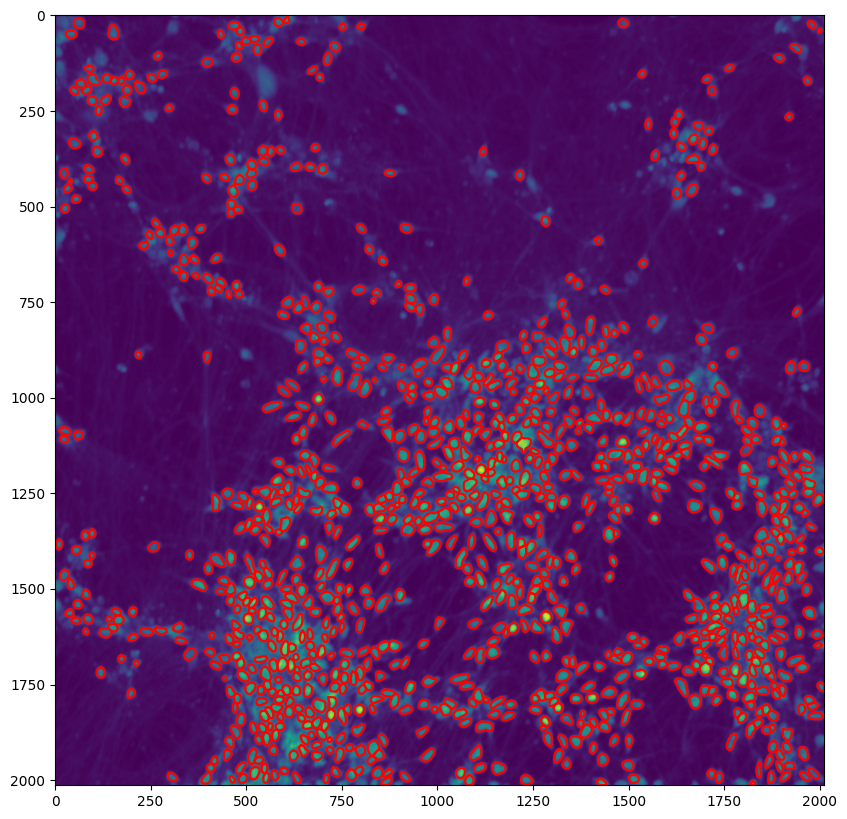

In [13]:
dat_167 = np.load('102522_D21_Coverslip8/test_Nuclei/167_seg.npy', allow_pickle=True).item()

# plot image with masks overlaid
mask_RGB = plot.mask_overlay(dat_167['img'], dat_167['masks'],
                        colors=np.array(dat_167['colors']))

# plot image with outlines overlaid in red
outlines = utils.outlines_list(dat_167['masks'])
plt.figure(figsize = (10,10))
plt.imshow(dat_167['img'])
for o in outlines:
    plt.plot(o[:,0], o[:,1], color='r')

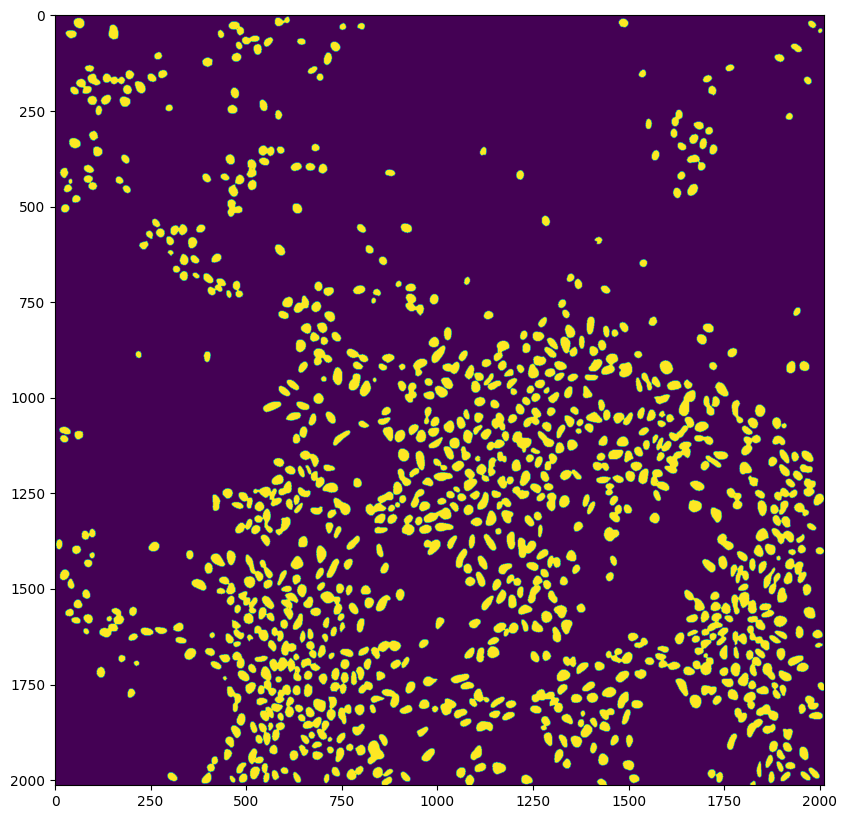

In [14]:
# This is just for calculating the F1 scores
mask_test_167 = dat_167['masks'] > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_test_167)

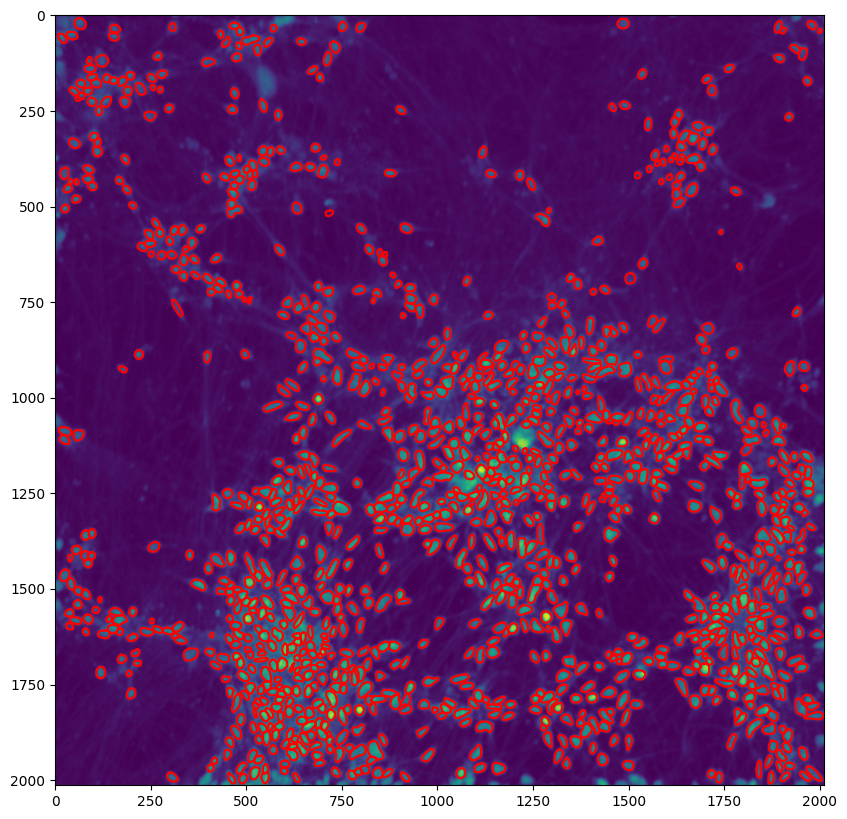

In [16]:
# Looking at Labels now

dat_lab_167 = np.load('102522_D21_Coverslip8/label_Nuclei/167_seg.npy', allow_pickle=True).item()

# plot image with masks overlaid
mask_RGB = plot.mask_overlay(dat_lab_167['img'], dat_lab_167['masks'],
                        colors=np.array(dat_lab_167['colors']))

# plot image with outlines overlaid in red
outlines = utils.outlines_list(dat_lab_167['masks'])
plt.figure(figsize = (10,10))
plt.imshow(dat_lab_167['img'])
for o in outlines:
    plt.plot(o[:,0], o[:,1], color='r')

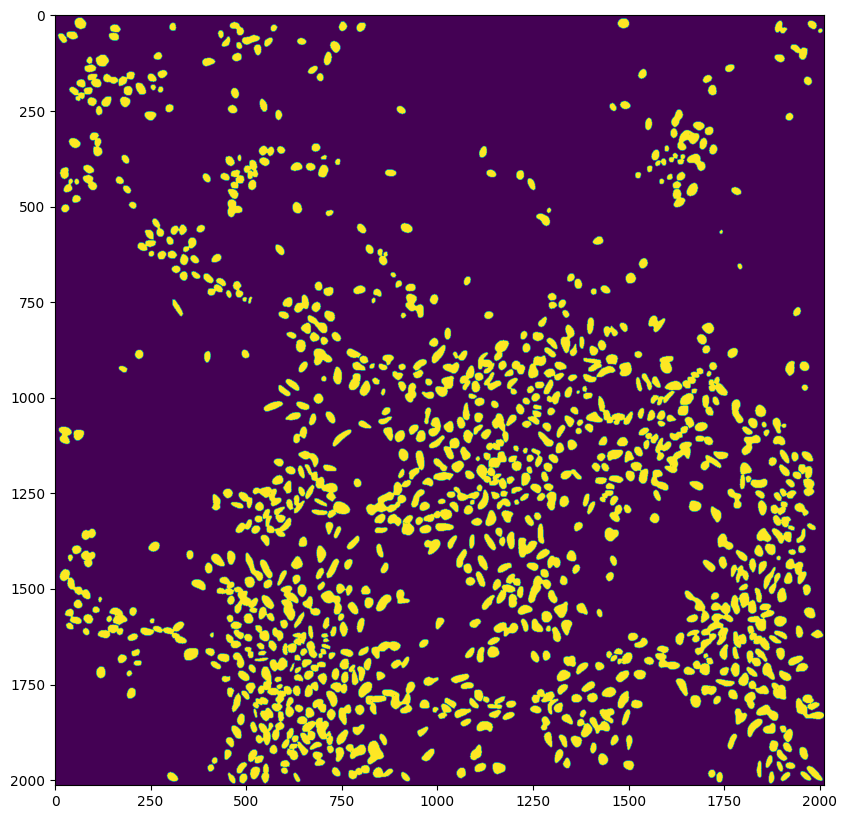

In [17]:
# Labeled mask
mask_lab_167 = dat_lab_167['masks'] > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_lab_167)

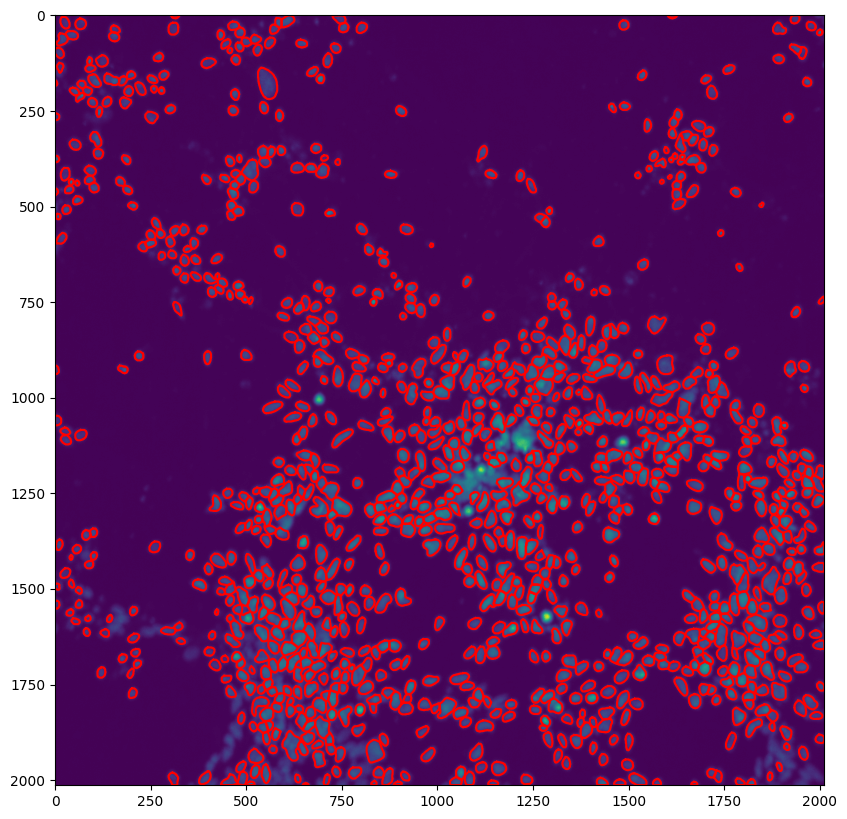

In [19]:
# Pretrained segmentation mask

dat_nuclei_167 = np.load('102522_D21_Coverslip8/Cellpose_Pretrained_nuclei/F167_max_seg.npy', allow_pickle=True).item()

# plot image with masks overlaid
mask_RGB = plot.mask_overlay(dat_nuclei_167['img'], dat_nuclei_167['masks'],
                        colors=np.array(dat_nuclei_167['colors']))

# plot image with outlines overlaid in red
outlines = utils.outlines_list(dat_nuclei_167['masks'])
plt.figure(figsize = (10,10))
plt.imshow(dat_nuclei_167['img'])
for o in outlines:
    plt.plot(o[:,0], o[:,1], color='r')

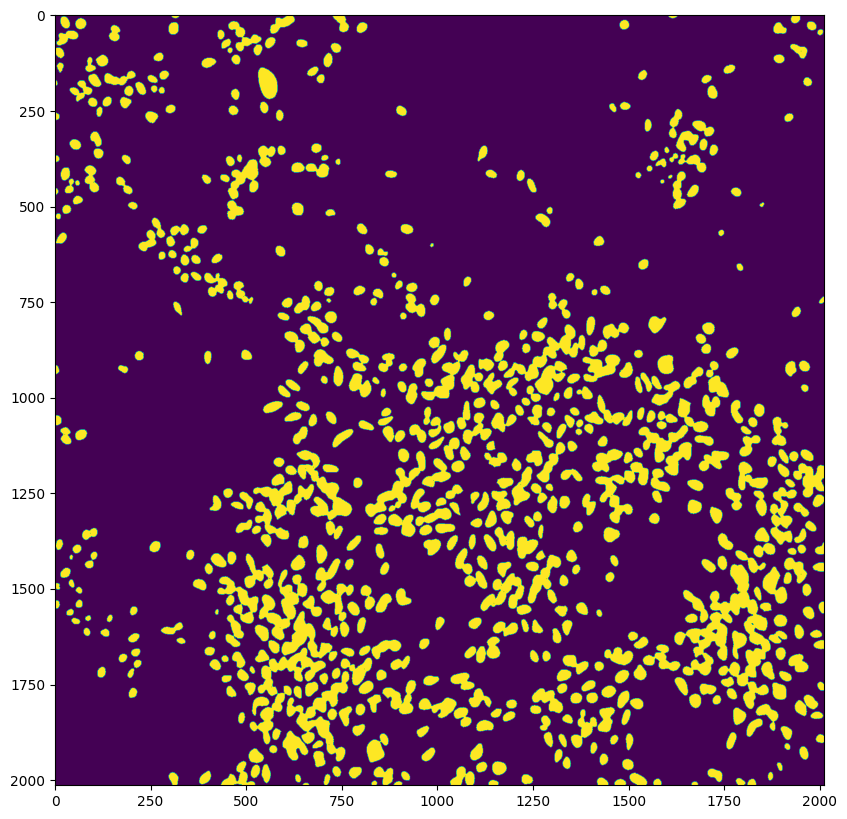

In [20]:
# nuclei mask
mask_nuclei_167 = dat_nuclei_167['masks'] > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_nuclei_167)

In [22]:
print(f1_score(mask_test_167, mask_lab_167) ,f1_score(mask_nuclei_167, mask_lab_167) )

0.8616679579733292 0.8017421068888945


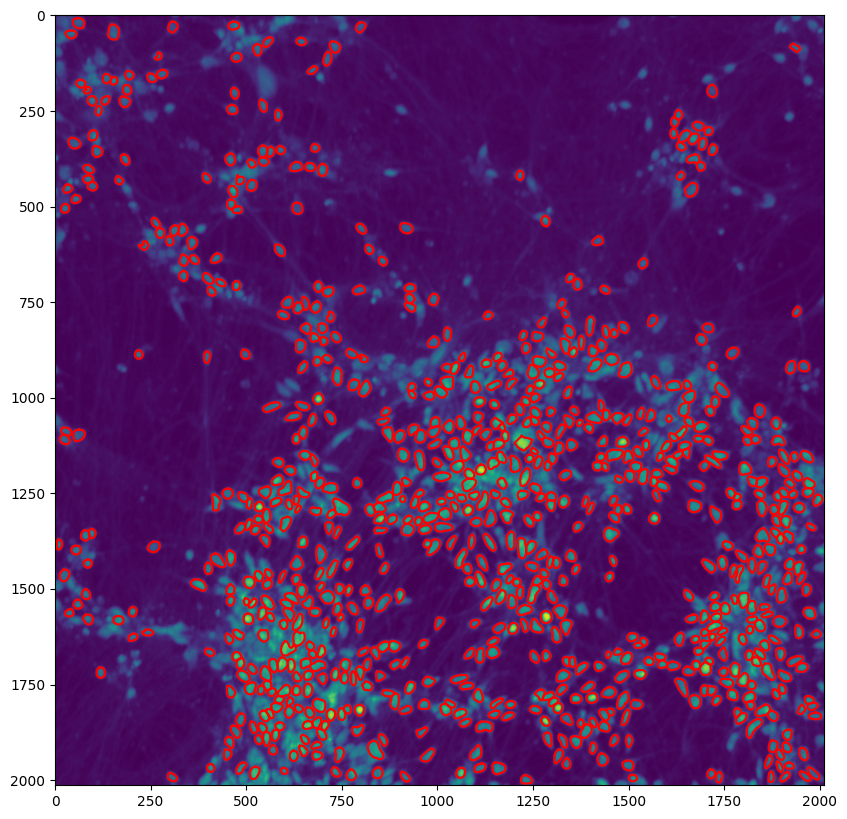

In [23]:
# previous D10 nuclei segmentation model mask

dat_nuclei_167 = np.load('102522_D21_Coverslip8/previous_nuclei_model/F167_max_seg.npy', allow_pickle=True).item()

# plot image with masks overlaid
mask_RGB = plot.mask_overlay(dat_nuclei_167['img'], dat_nuclei_167['masks'],
                        colors=np.array(dat_nuclei_167['colors']))

# plot image with outlines overlaid in red
outlines = utils.outlines_list(dat_nuclei_167['masks'])
plt.figure(figsize = (10,10))
plt.imshow(dat_nuclei_167['img'])
for o in outlines:
    plt.plot(o[:,0], o[:,1], color='r')

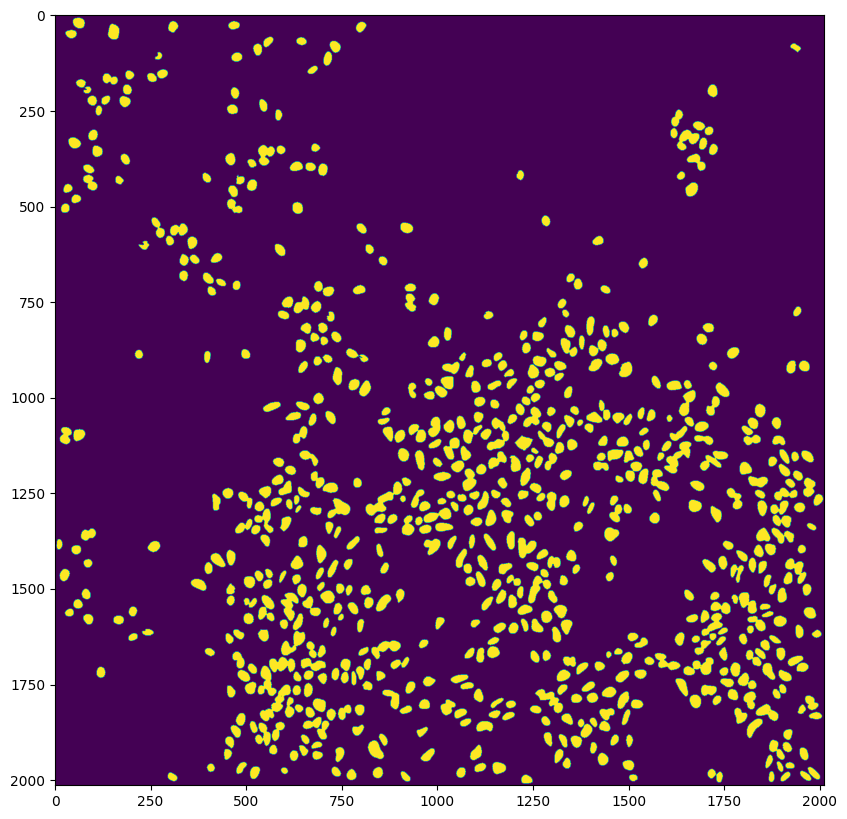

In [24]:
# nuclei mask
mask_nuclei_167 = dat_nuclei_167['masks'] > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_nuclei_167)

In [25]:
print(f1_score(mask_test_167, mask_lab_167) ,f1_score(mask_nuclei_167, mask_lab_167) )

0.8616679579733292 0.7806320484128979


In [ ]:
# nuclei model output -- 1064 cells
# label -- 1207 cells
# test -- 1072 cells
# previous model -- 817 cells 

# the D21 nuclei model works better than both previous D10 nuclei model as well as the pretrained nuclei model  

# Soma

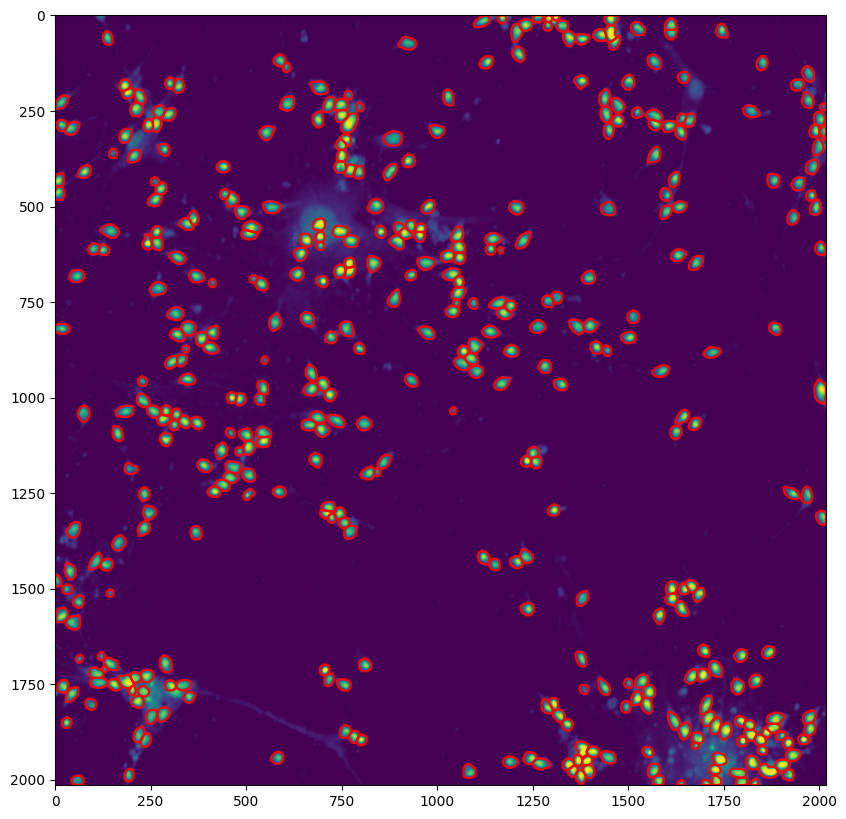

In [99]:
# Masks tested with trained model

dat = np.load('Cov1_test/F193_mc_test_seg.npy', allow_pickle=True).item()

# plot image with masks overlaid
mask_RGB = plot.mask_overlay(dat['img'], dat['masks'],
                        colors=np.array(dat['colors']))

# plot image with outlines overlaid in red
outlines = utils.outlines_list(dat['masks'])
plt.figure(figsize = (10,10))
plt.imshow(dat['img'][..., 0])
for o in outlines:
    plt.plot(o[:,0], o[:,1], color='r')

In [14]:
dat['masks'].shape

(2015, 2018)

In [47]:
outlines

[array([[1161,    0],
        [1160,    1],
        [1159,    1],
        [1159,    2],
        [1159,    3],
        [1158,    4],
        [1158,    5],
        [1158,    6],
        [1158,    7],
        [1158,    8],
        [1158,    9],
        [1158,   10],
        [1158,   11],
        [1159,   12],
        [1159,   13],
        [1160,   14],
        [1160,   15],
        [1161,   16],
        [1162,   17],
        [1163,   18],
        [1164,   19],
        [1165,   20],
        [1166,   20],
        [1167,   21],
        [1168,   21],
        [1169,   21],
        [1170,   21],
        [1171,   21],
        [1172,   21],
        [1173,   21],
        [1174,   20],
        [1175,   20],
        [1176,   19],
        [1177,   18],
        [1178,   17],
        [1179,   16],
        [1179,   15],
        [1180,   14],
        [1180,   13],
        [1181,   12],
        [1181,   11],
        [1182,   10],
        [1182,    9],
        [1182,    8],
        [1182,    7],
        [1

In [15]:
np.sum(dat['masks'])

71039520

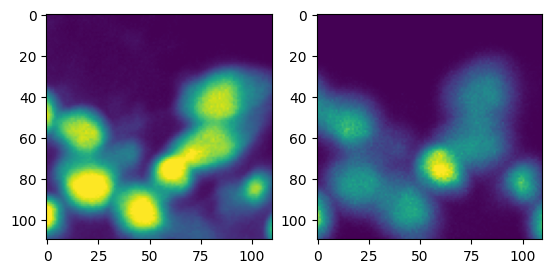

In [46]:
fig, ax = plt.subplots(1, 2)
ax[0].imshow(dat['img'][1800:1910, 1800:1910, 0])
ax[1].imshow(dat['img'][1800:1910, 1800:1910, 1])


# for o in outlines:
#     plt.plot(o[:,0], o[:,1], color='r')

In [44]:
dat['masks'][1850:1890, 1850:1890]

array([[  0,   0,   0, ..., 360, 360, 360],
       [  0,   0,   0, ..., 360, 360, 360],
       [  0,   0,   0, ..., 360, 360, 360],
       ...,
       [379, 379, 379, ..., 375, 375, 375],
       [379, 379, 379, ..., 375, 375, 375],
       [379, 379, 379, ..., 375, 375, 375]], dtype=uint16)

In [48]:
dat['masks'][1850:1860, 1850:1860]

array([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]], dtype=uint16)

In [49]:
dat['masks'][1880:1890, 1880:1890]

array([[  0,   0,   0,   0,   0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0, 375],
       [  0,   0,   0,   0,   0,   0,   0,   0, 375, 375],
       [  0,   0,   0,   0,   0,   0,   0, 375, 375, 375],
       [  0,   0,   0,   0,   0,   0, 375, 375, 375, 375],
       [  0,   0,   0,   0,   0,   0, 375, 375, 375, 375],
       [  0,   0,   0,   0,   0, 375, 375, 375, 375, 375],
       [  0,   0,   0,   0,   0, 375, 375, 375, 375, 375],
       [  0,   0,   0,   0,   0,   0, 375, 375, 375, 375],
       [  0,   0,   0,   0,   0,   0, 375, 375, 375, 375]], dtype=uint16)

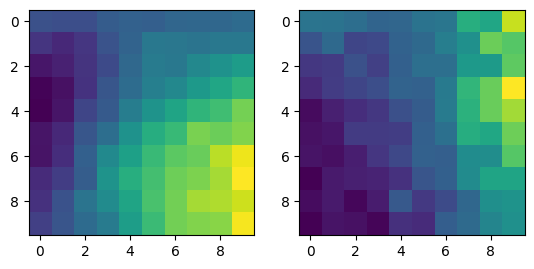

In [50]:
fig, ax = plt.subplots(1, 2)
ax[0].imshow(dat['img'][1880:1890, 1880:1890, 0])    #0th is the Soma, which the mask matches up with 
ax[1].imshow(dat['img'][1880:1890, 1880:1890, 1])

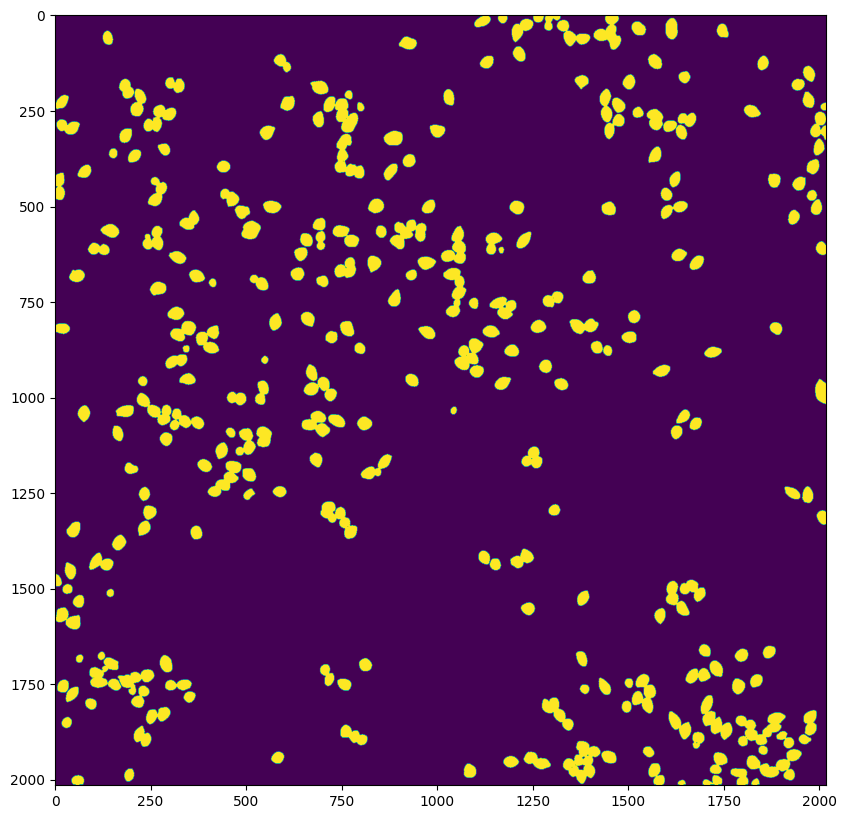

In [72]:
# This is just for calculating the F1 scores
mask_test = dat['masks'] > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_test)

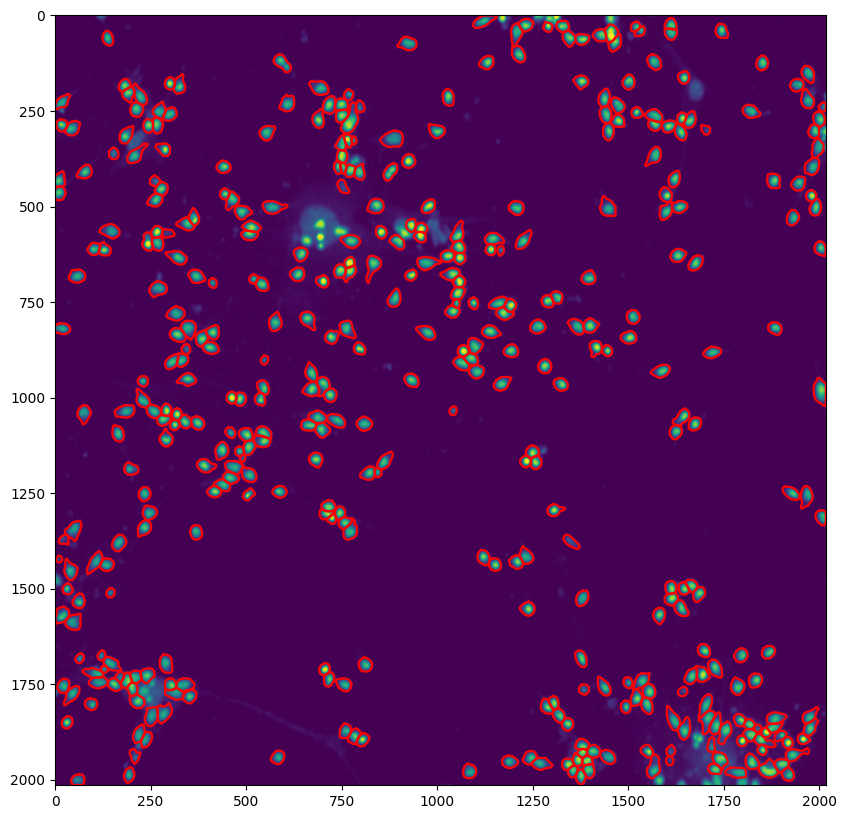

In [68]:
# Looking at Labels now

dat_lab = np.load('Cov1_test_labels/F193_mc_test_seg.npy', allow_pickle=True).item()

# plot image with masks overlaid
mask_RGB = plot.mask_overlay(dat_lab['img'], dat_lab['masks'],
                        colors=np.array(dat_lab['colors']))

# plot image with outlines overlaid in red
outlines = utils.outlines_list(dat_lab['masks'])
plt.figure(figsize = (10,10))
plt.imshow(dat_lab['img'])
for o in outlines:
    plt.plot(o[:,0], o[:,1], color='r')

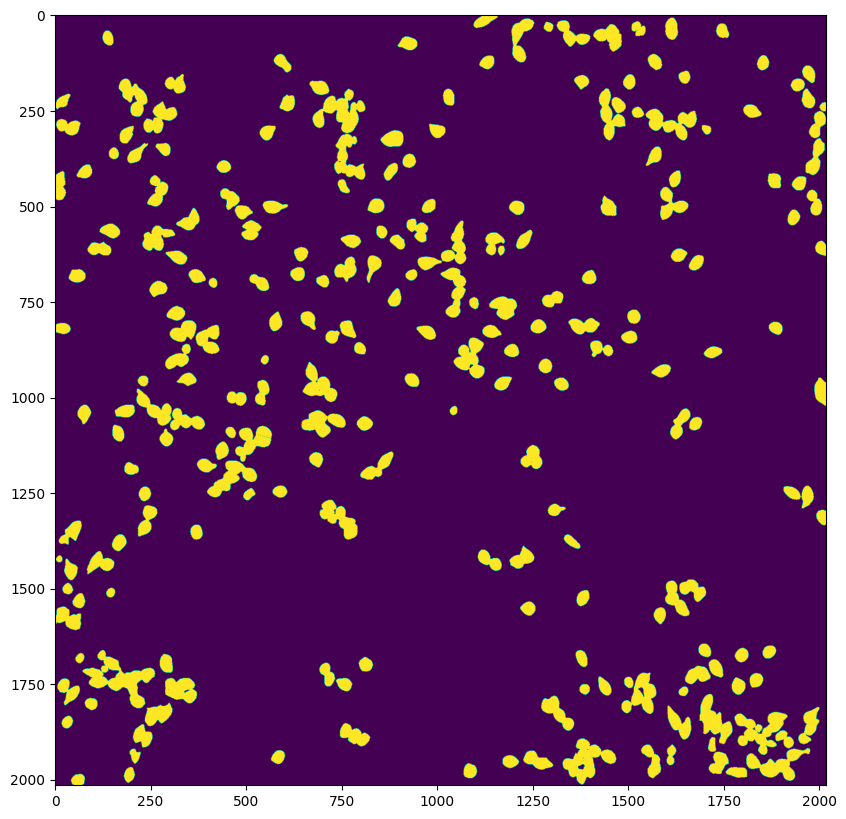

In [69]:
# Labeled mask
mask_lab = dat_lab['masks'] > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_lab)

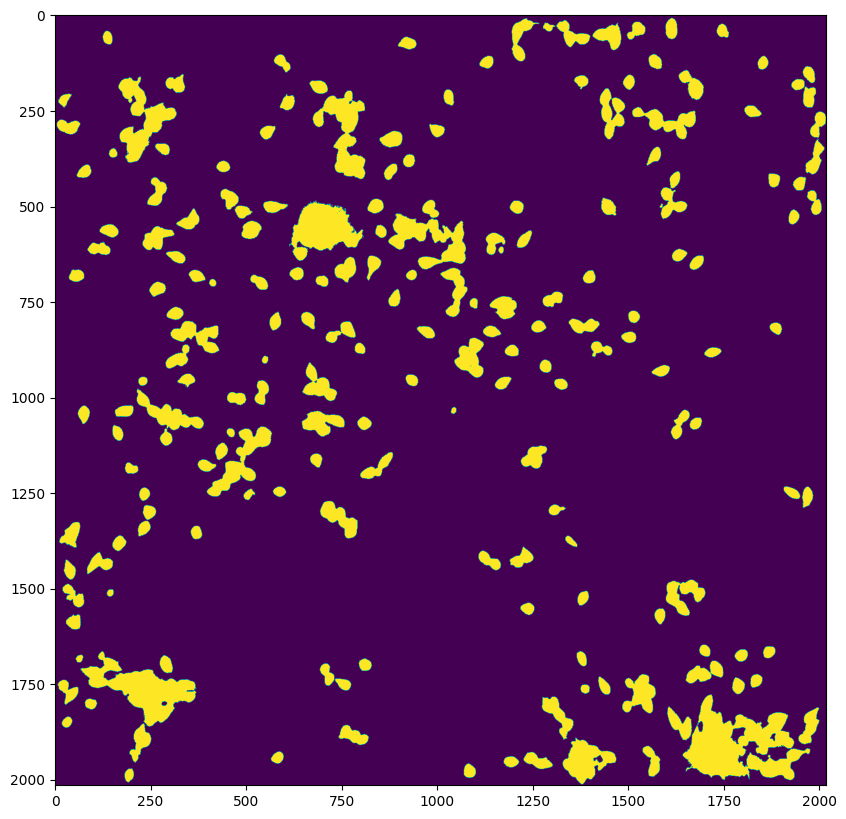

In [67]:
# Cell Profiler segmentation mask
cp = imread("Cov1_cp_output/F193_max_clean_Soma.tiff")
mask_cp = cp > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_cp)

In [90]:
a = np.array([True, True, False])
b = np.array([False, True, False])

# a = a.astype(int)
# b = b.astype(int)

np.count_nonzero(np.logical_and(a == True, b == False))

1

In [91]:
np.count_nonzero(np.logical_and(mask_test, mask_lab))

331858

In [96]:
f1_score(mask_test, mask_lab)  

0.8911487445403854

In [97]:
f1_score(mask_cp, mask_lab)

0.8522725699404781

# 018

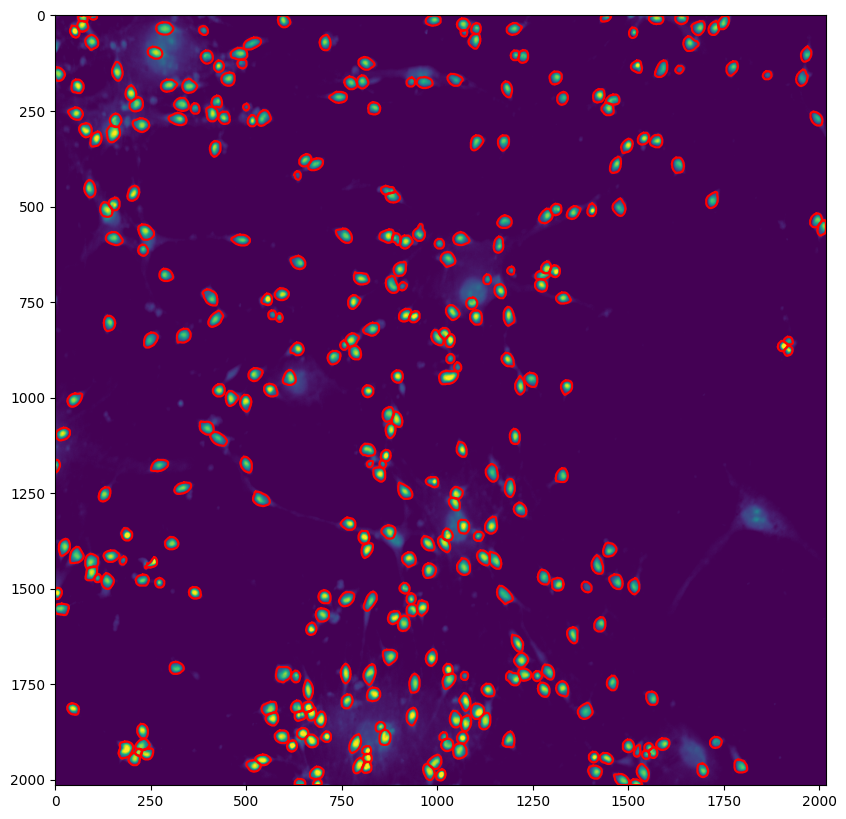

In [102]:
# Masks tested with trained model

dat_test_018 = np.load('Cov1_test/F018_mc_test_seg.npy', allow_pickle=True).item()

# plot image with masks overlaid
mask_RGB = plot.mask_overlay(dat_test_018['img'], dat_test_018['masks'],
                        colors=np.array(dat_test_018['colors']))

# plot image with outlines overlaid in red
outlines = utils.outlines_list(dat_test_018['masks'])
plt.figure(figsize = (10,10))
plt.imshow(dat_test_018['img'][..., 0])
for o in outlines:
    plt.plot(o[:,0], o[:,1], color='r')

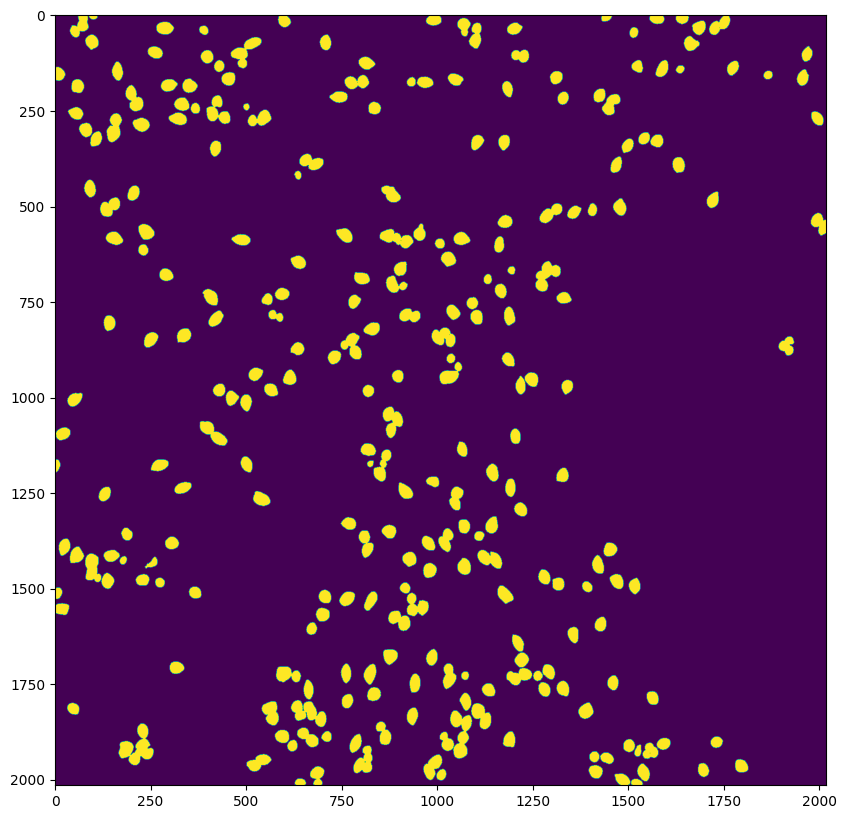

In [103]:
# This is just for calculating the F1 scores
mask_test_018 = dat_test_018['masks'] > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_test_018)

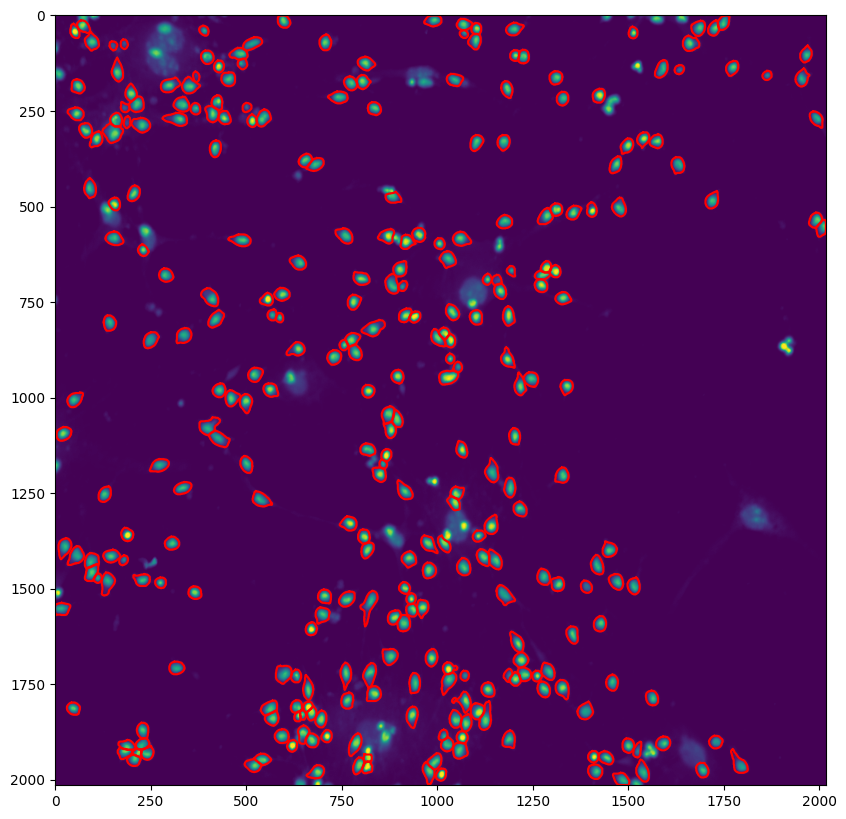

In [104]:
# Looking at Labels now

dat_lab_018 = np.load('Cov1_test_labels/F018_mc_test_seg.npy', allow_pickle=True).item()

# plot image with masks overlaid
mask_RGB = plot.mask_overlay(dat_lab_018['img'], dat_lab_018['masks'],
                        colors=np.array(dat_lab_018['colors']))

# plot image with outlines overlaid in red
outlines = utils.outlines_list(dat_lab_018['masks'])
plt.figure(figsize = (10,10))
plt.imshow(dat_lab_018['img'])
for o in outlines:
    plt.plot(o[:,0], o[:,1], color='r')

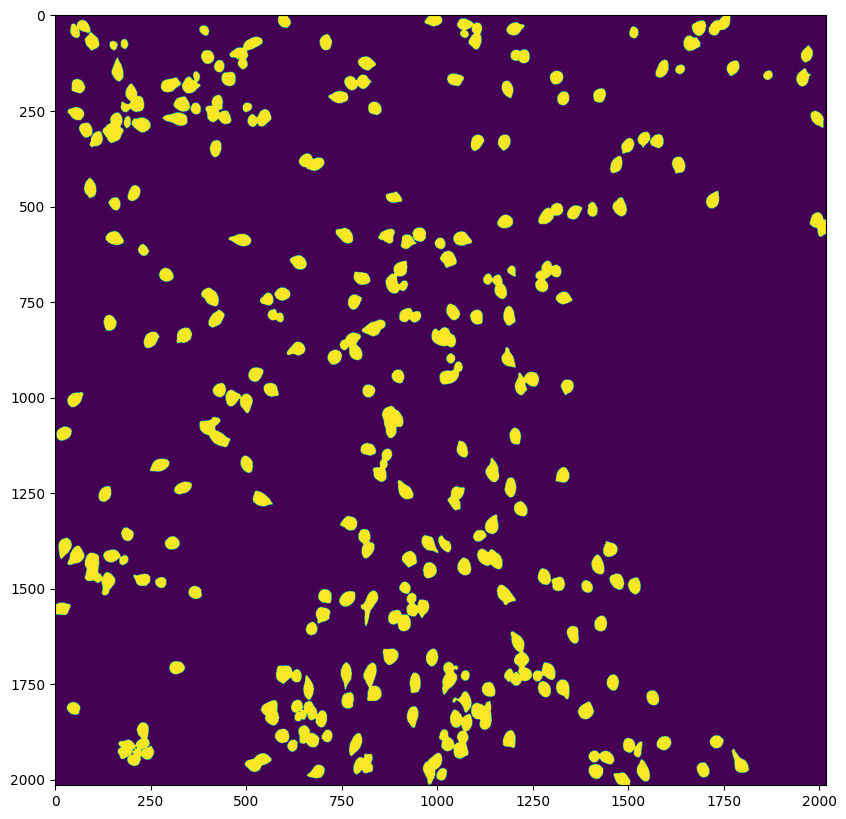

In [105]:
# This is just for calculating the F1 scores
mask_lab_018 = dat_lab_018['masks'] > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_lab_018)

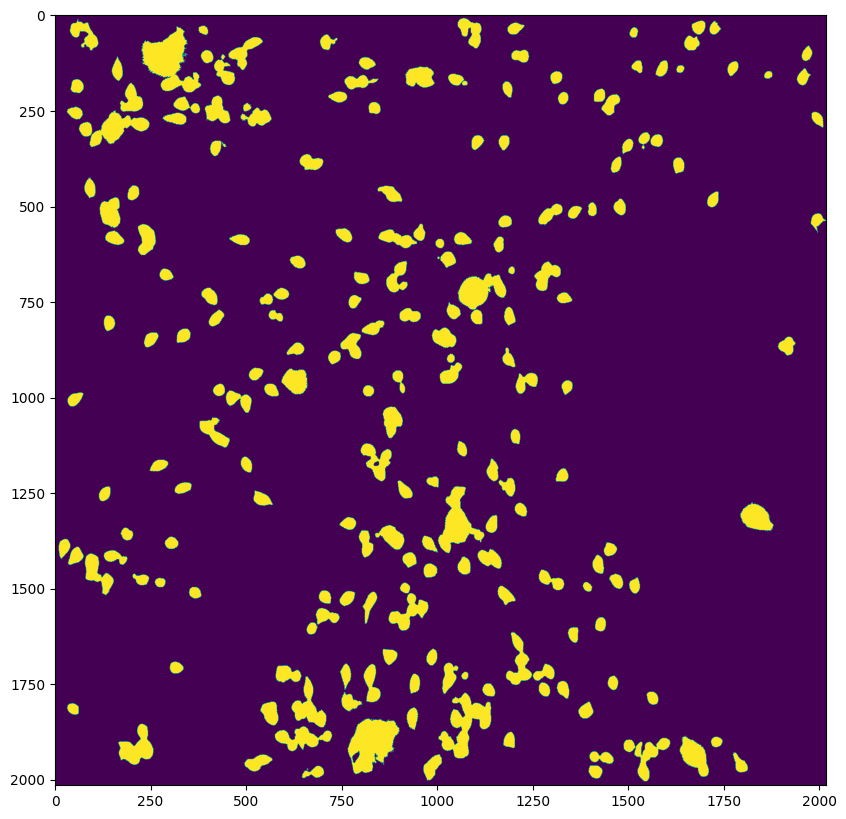

In [106]:
# Cell Profiler segmentation mask
cp_018 = imread("Cov1_cp_output/F018_max_clean_Soma.tiff")
mask_cp_018 = cp_018 > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_cp_018)

In [107]:
f1_score(mask_test_018, mask_lab_018) 

0.872507931012673

In [108]:
f1_score(mask_cp_018, mask_lab_018) 

0.8067168824701195

# 204

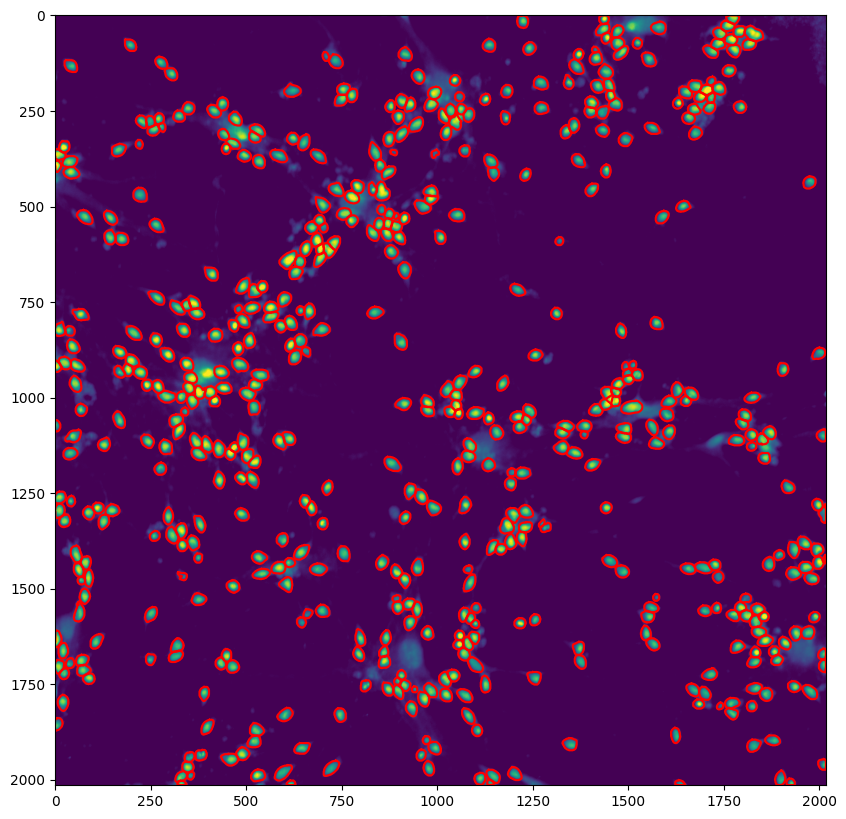

In [109]:
# Masks tested with trained model

dat_test_204 = np.load('Cov1_test/F204_mc_test_seg.npy', allow_pickle=True).item()

# plot image with masks overlaid
mask_RGB = plot.mask_overlay(dat_test_204['img'], dat_test_204['masks'],
                        colors=np.array(dat_test_204['colors']))

# plot image with outlines overlaid in red
outlines = utils.outlines_list(dat_test_204['masks'])
plt.figure(figsize = (10,10))
plt.imshow(dat_test_204['img'][..., 0])
for o in outlines:
    plt.plot(o[:,0], o[:,1], color='r')

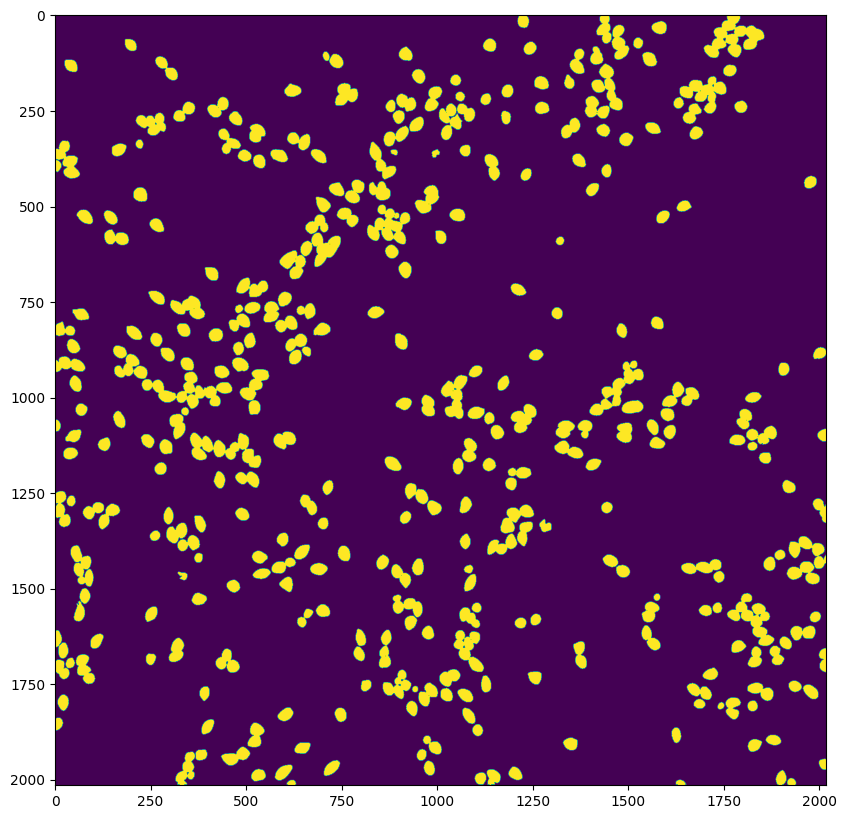

In [110]:
# This is just for calculating the F1 scores
mask_test_204 = dat_test_204['masks'] > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_test_204)

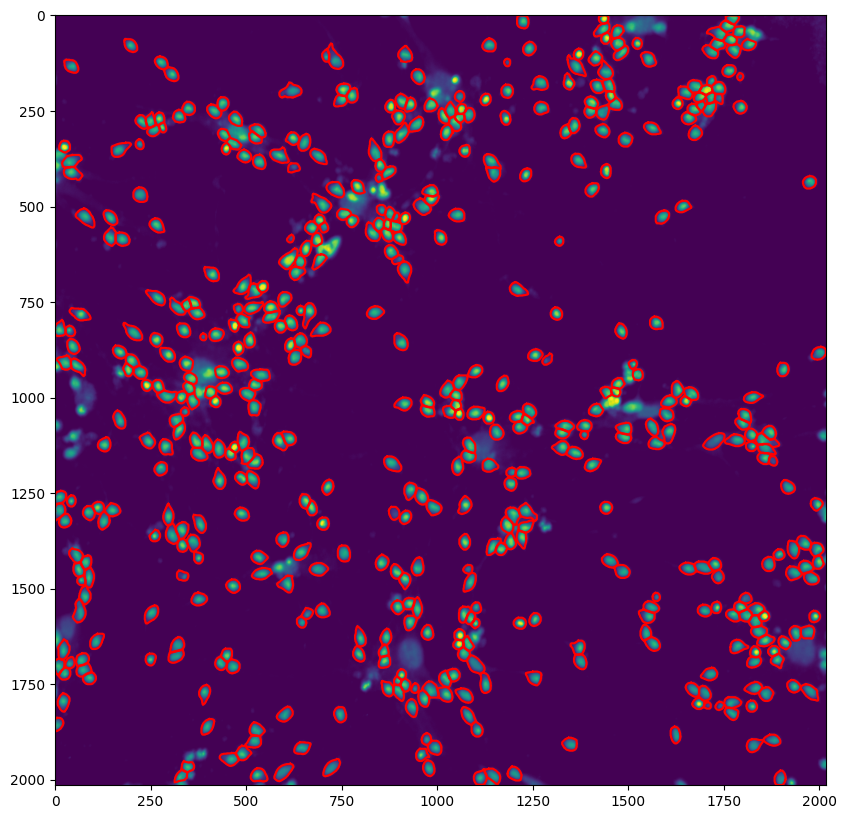

In [111]:
# Looking at Labels now

dat_lab_204 = np.load('Cov1_test_labels/F204_mc_test_seg.npy', allow_pickle=True).item()

# plot image with masks overlaid
mask_RGB = plot.mask_overlay(dat_lab_204['img'], dat_lab_204['masks'],
                        colors=np.array(dat_lab_204['colors']))

# plot image with outlines overlaid in red
outlines = utils.outlines_list(dat_lab_204['masks'])
plt.figure(figsize = (10,10))
plt.imshow(dat_lab_204['img'])
for o in outlines:
    plt.plot(o[:,0], o[:,1], color='r')

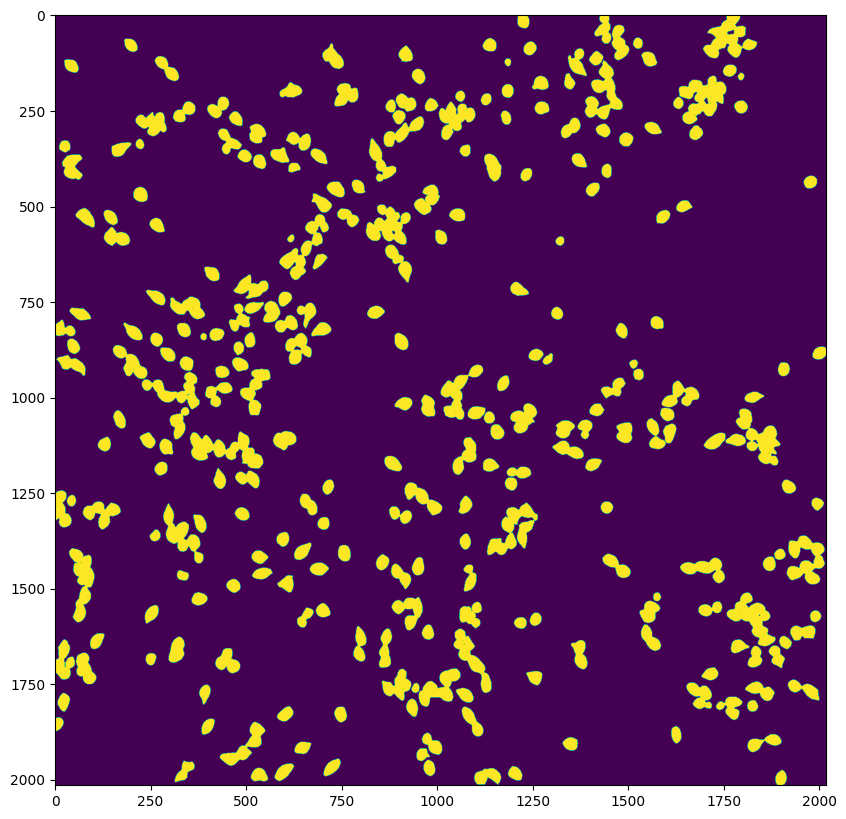

In [112]:
# This is just for calculating the F1 scores
mask_lab_204 = dat_lab_204['masks'] > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_lab_204)

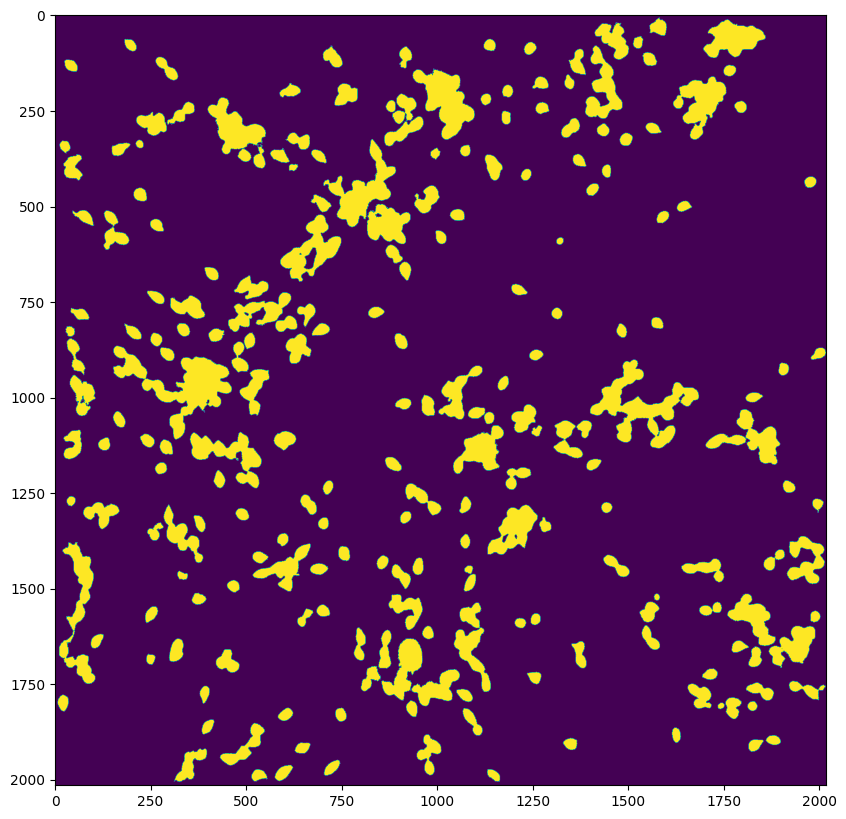

In [113]:
# Cell Profiler segmentation mask
cp_204 = imread("Cov1_cp_output/F204_max_clean_Soma.tiff")
mask_cp_204 = cp_204 > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_cp_204)

In [126]:
print(f1_score(mask_test_204, mask_lab_204) , f1_score(mask_cp_204, mask_lab_204) )

0.8914898037426615 0.8363176225606123


# Nuclei

# 018

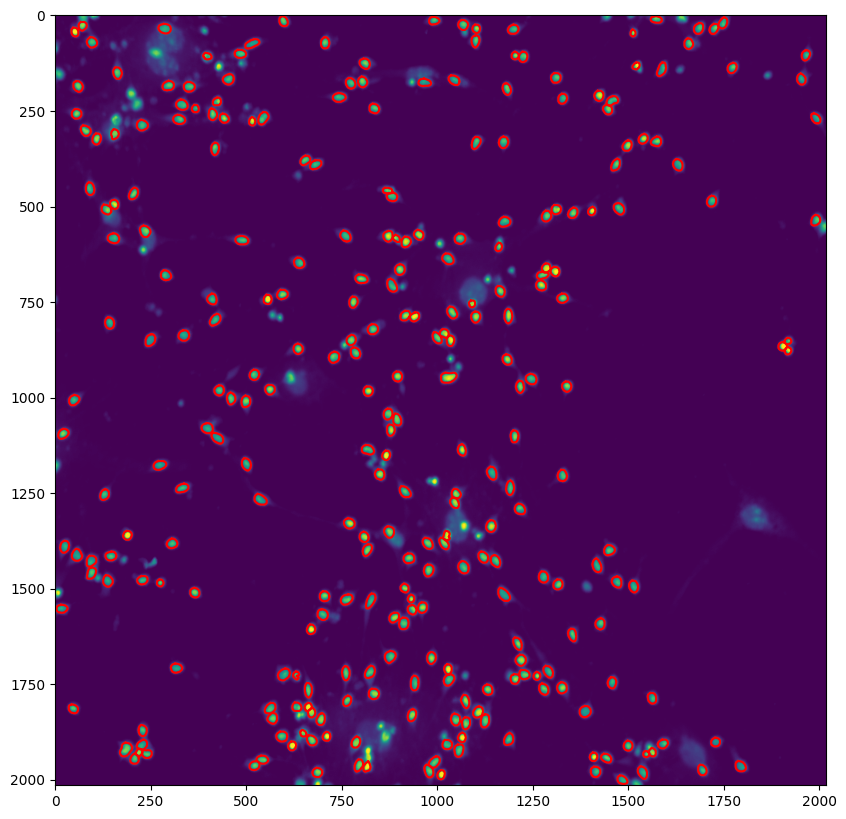

In [43]:
# Masks tested with trained model

dat_test_nuc_018 = np.load('Cov_1_Nuc_Cellpose/test/F018_mc_test_seg.npy', allow_pickle=True).item()

# plot image with masks overlaid
mask_RGB = plot.mask_overlay(dat_test_nuc_018['img'], dat_test_nuc_018['masks'],
                        colors=np.array(dat_test_nuc_018['colors']))

# plot image with outlines overlaid in red
outlines = utils.outlines_list(dat_test_nuc_018['masks'])
plt.figure(figsize = (10,10))
plt.imshow(dat_test_nuc_018['img'])
for o in outlines:
    plt.plot(o[:,0], o[:,1], color='r')

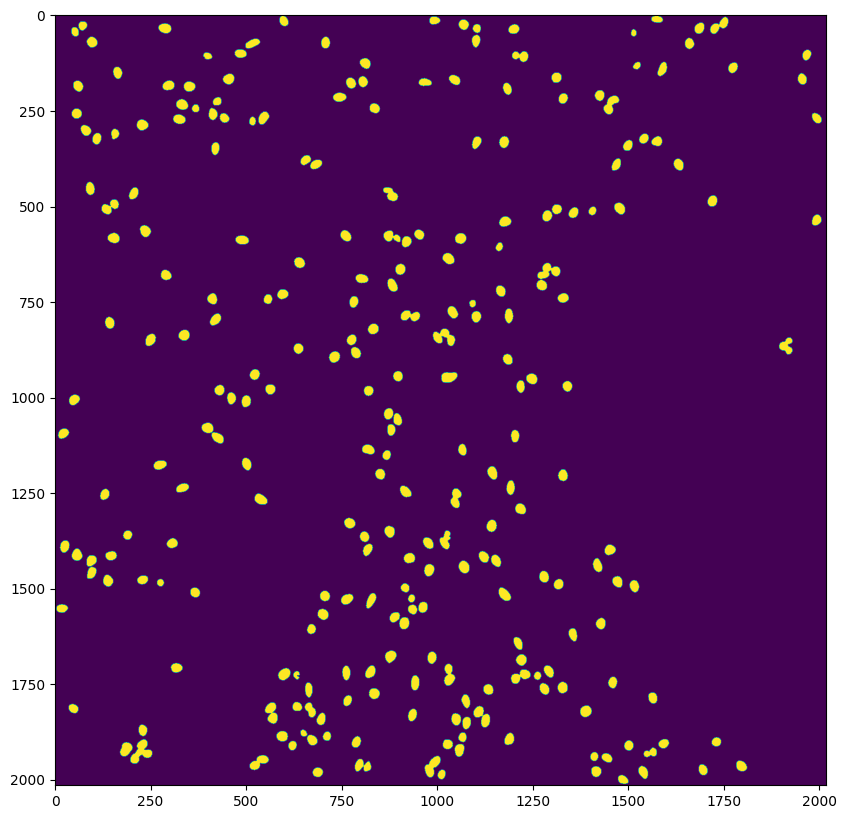

In [26]:
# This is just for calculating the F1 scores
mask_test_nuc_018 = dat_test_nuc_018['masks'] > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_test_nuc_018)

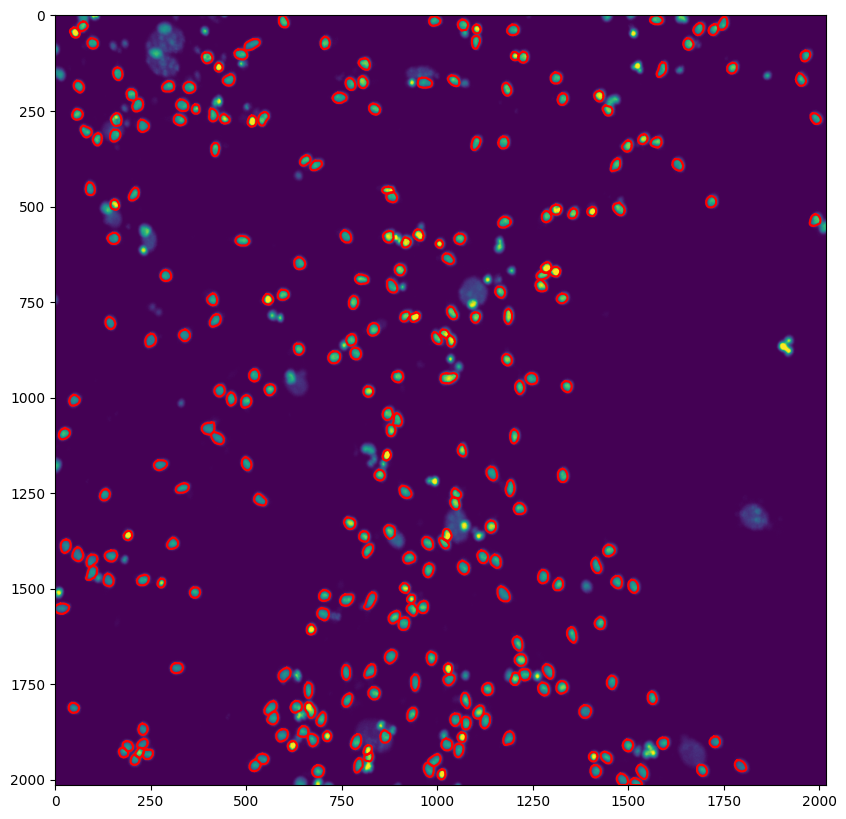

In [44]:
# Looking at Labels now

dat_lab_nuc_018 = np.load('Cov_1_Nuc_Cellpose/Label/F018_mc_test_seg.npy', allow_pickle=True).item()

# plot image with masks overlaid
mask_RGB = plot.mask_overlay(dat_lab_nuc_018['img'], dat_lab_nuc_018['masks'],
                        colors=np.array(dat_lab_nuc_018['colors']))

# plot image with outlines overlaid in red
outlines = utils.outlines_list(dat_lab_nuc_018['masks'])
plt.figure(figsize = (10,10))
plt.imshow(dat_lab_nuc_018['img'])
for o in outlines:
    plt.plot(o[:,0], o[:,1], color='r')

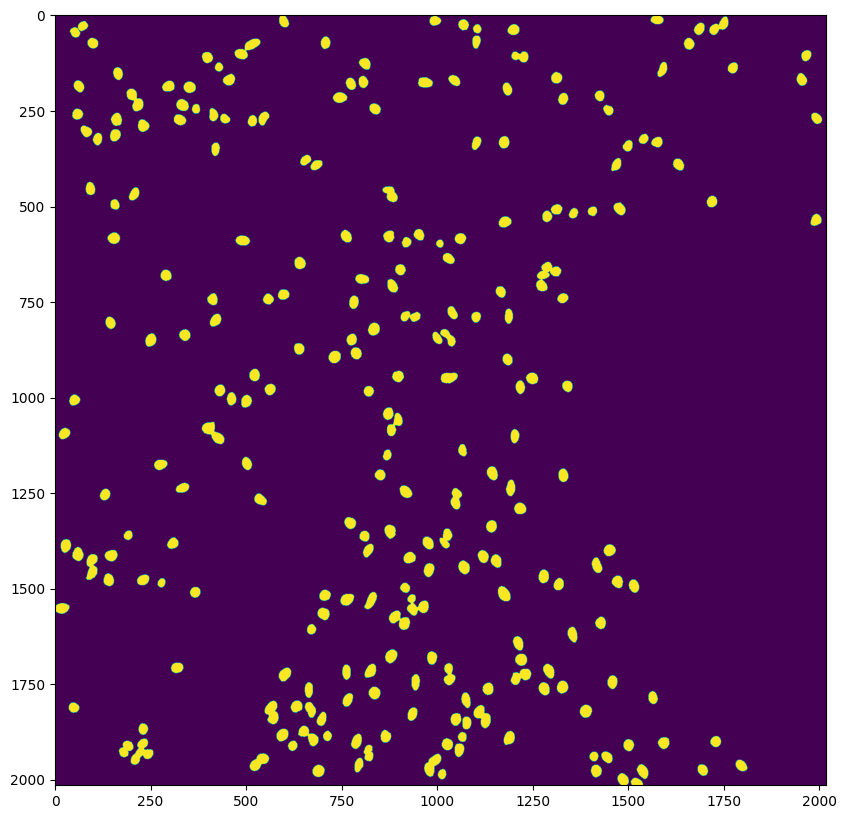

In [45]:
# This is just for calculating the F1 scores
mask_lab_nuc_018 = dat_lab_nuc_018['masks'] > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_lab_nuc_018)

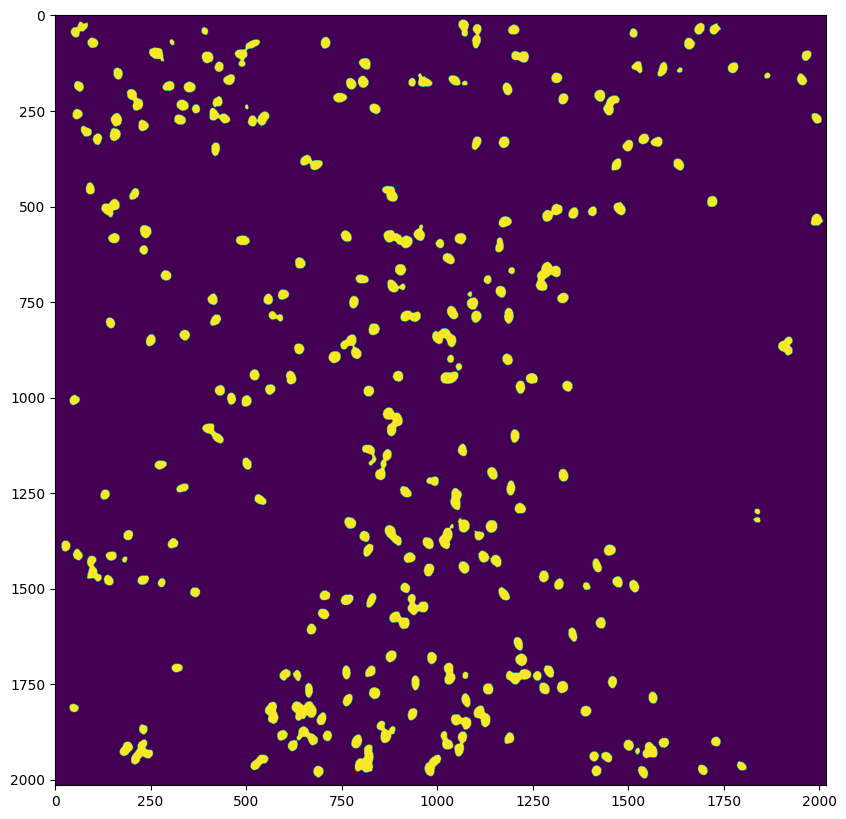

In [29]:
# Cell Profiler segmentation mask
cp_nuc_018 = imread("Cov_1_Nuc_Cellpose/cp/F018_max_clean_Nuclei.tiff")
mask_cp_nuc_018 = cp_nuc_018 > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_cp_nuc_018)

In [46]:
print(f1_score(mask_test_nuc_018, mask_lab_nuc_018) ,f1_score(mask_cp_nuc_018, mask_lab_nuc_018) )

0.8546112253223339 0.8513118913255076


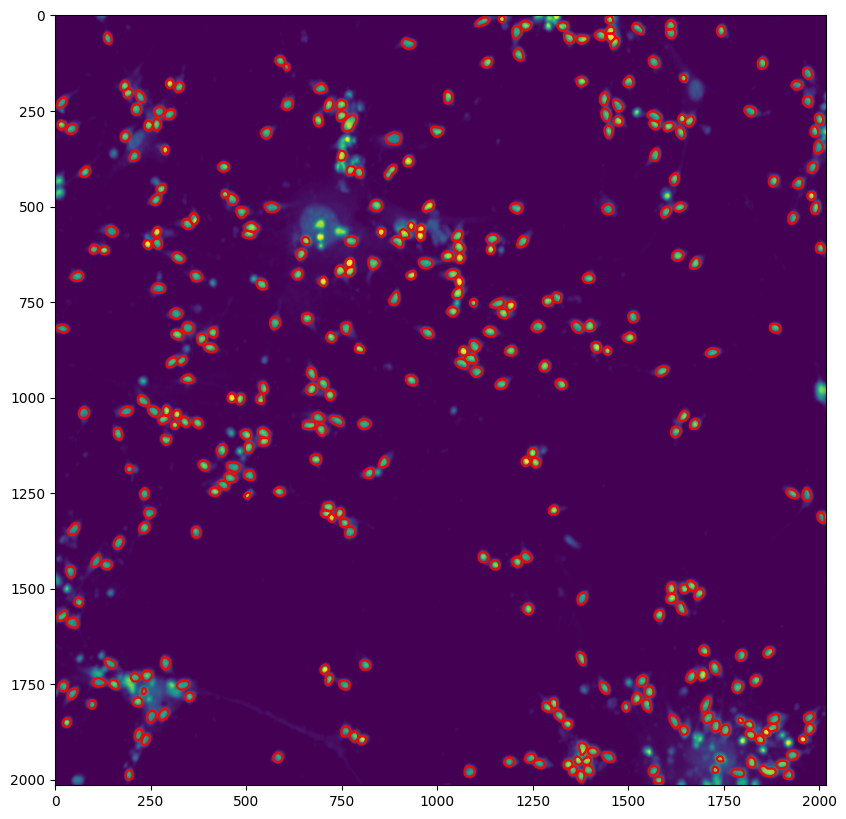

In [31]:
# Masks tested with trained model

dat_test_nuc_193 = np.load('Cov_1_Nuc_Cellpose/test/F193_mc_test_seg.npy', allow_pickle=True).item()

# plot image with masks overlaid
mask_RGB = plot.mask_overlay(dat_test_nuc_193['img'], dat_test_nuc_193['masks'],
                        colors=np.array(dat_test_nuc_193['colors']))

# plot image with outlines overlaid in red
outlines = utils.outlines_list(dat_test_nuc_193['masks'])
plt.figure(figsize = (10,10))
plt.imshow(dat_test_nuc_193['img'])
for o in outlines:
    plt.plot(o[:,0], o[:,1], color='r')

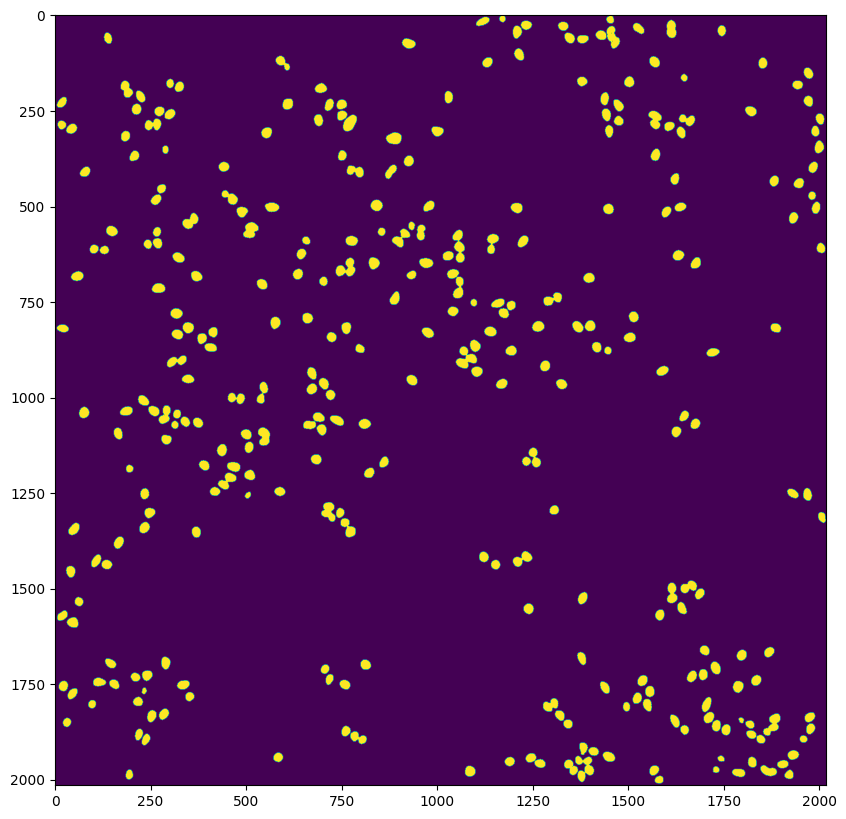

In [32]:
# This is just for calculating the F1 scores
mask_test_nuc_193 = dat_test_nuc_193['masks'] > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_test_nuc_193)

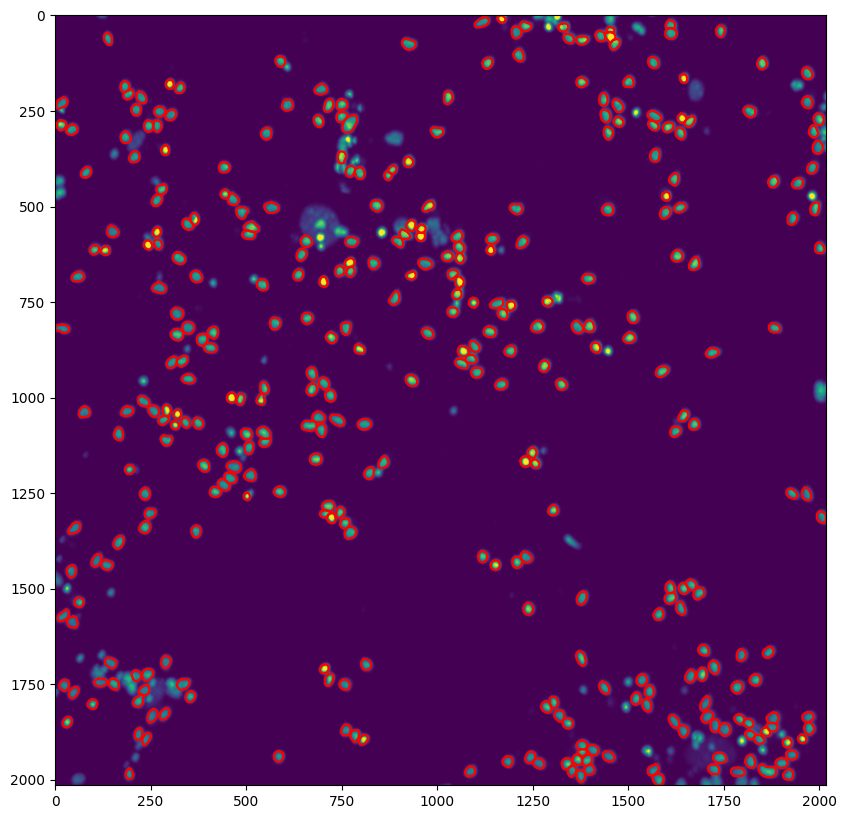

In [53]:
# Looking at Labels now

dat_lab_nuc_193 = np.load('Cov_1_Nuc_Cellpose/Label/F193_mc_test_seg.npy', allow_pickle=True).item()

# plot image with masks overlaid
mask_RGB = plot.mask_overlay(dat_lab_nuc_193['img'], dat_lab_nuc_193['masks'],
                        colors=np.array(dat_lab_nuc_193['colors']))

# plot image with outlines overlaid in red
outlines = utils.outlines_list(dat_lab_nuc_193['masks'])
plt.figure(figsize = (10,10))
plt.imshow(dat_lab_nuc_193['img'])
for o in outlines:
    plt.plot(o[:,0], o[:,1], color='r')

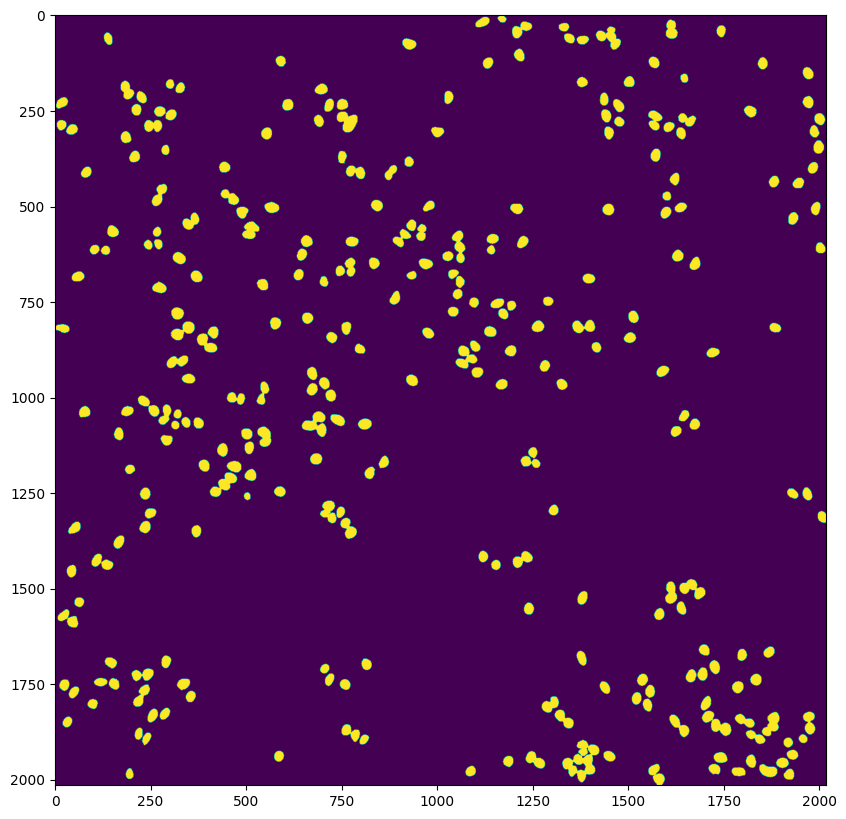

In [54]:
# This is just for calculating the F1 scores
mask_lab_nuc_193 = dat_lab_nuc_193['masks'] > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_lab_nuc_193)

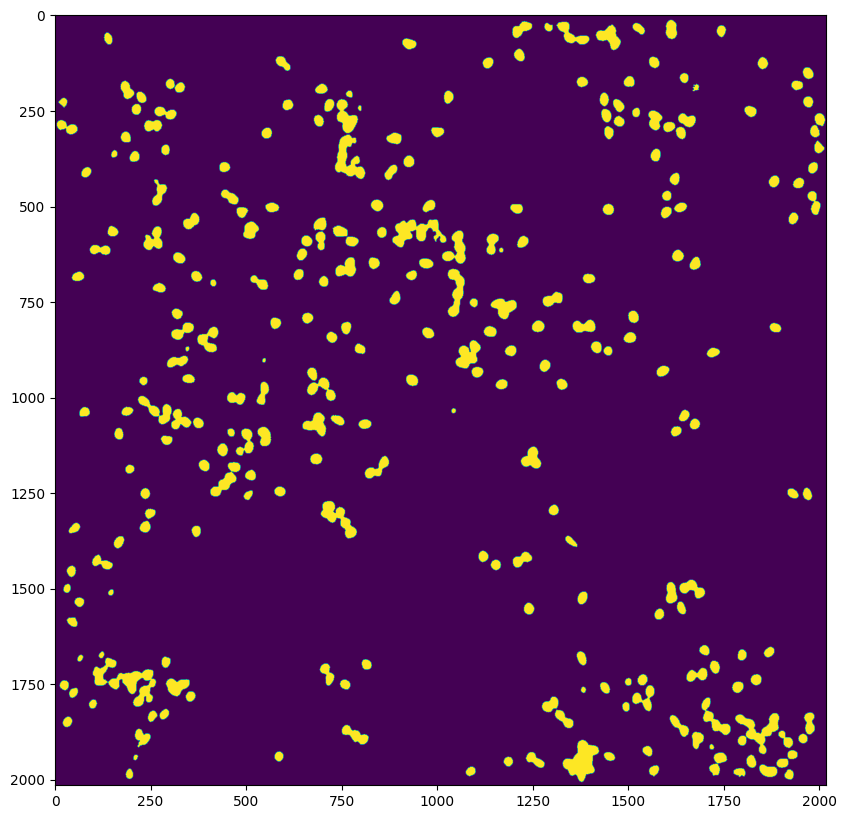

In [35]:
# Cell Profiler segmentation mask
cp_nuc_193 = imread("Cov_1_Nuc_Cellpose/cp/F193_max_clean_Nuclei.tiff")
mask_cp_nuc_193 = cp_nuc_193 > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_cp_nuc_193)

In [55]:
print(f1_score(mask_test_nuc_193, mask_lab_nuc_193) ,f1_score(mask_cp_nuc_193, mask_lab_nuc_193) )

0.8652873765179024 0.8689466590975078


# 204

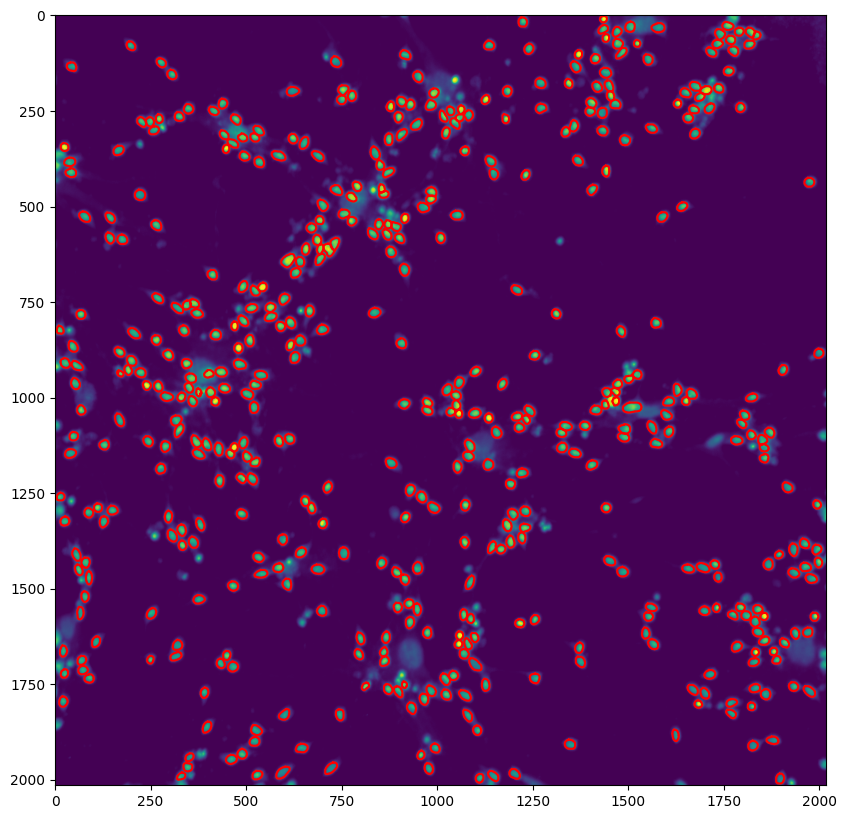

In [37]:
# Masks tested with trained model

dat_test_nuc_204 = np.load('Cov_1_Nuc_Cellpose/test/F204_mc_test_seg.npy', allow_pickle=True).item()

# plot image with masks overlaid
mask_RGB = plot.mask_overlay(dat_test_nuc_204['img'], dat_test_nuc_204['masks'],
                        colors=np.array(dat_test_nuc_204['colors']))

# plot image with outlines overlaid in red
outlines = utils.outlines_list(dat_test_nuc_204['masks'])
plt.figure(figsize = (10,10))
plt.imshow(dat_test_nuc_204['img'])
for o in outlines:
    plt.plot(o[:,0], o[:,1], color='r')

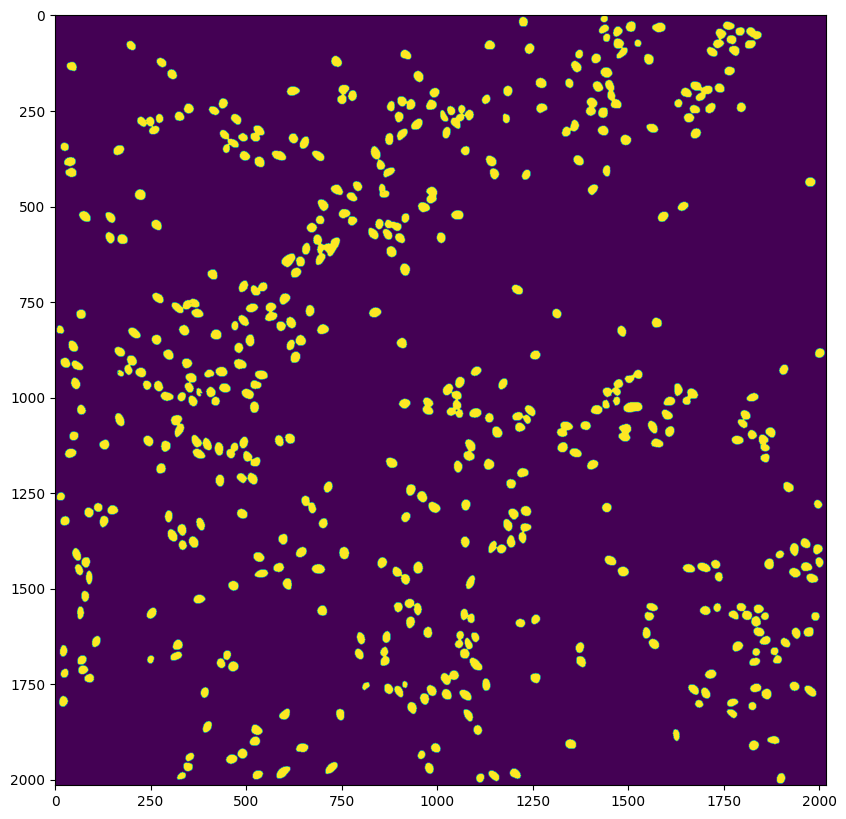

In [38]:
# This is just for calculating the F1 scores
mask_test_nuc_204 = dat_test_nuc_204['masks'] > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_test_nuc_204)

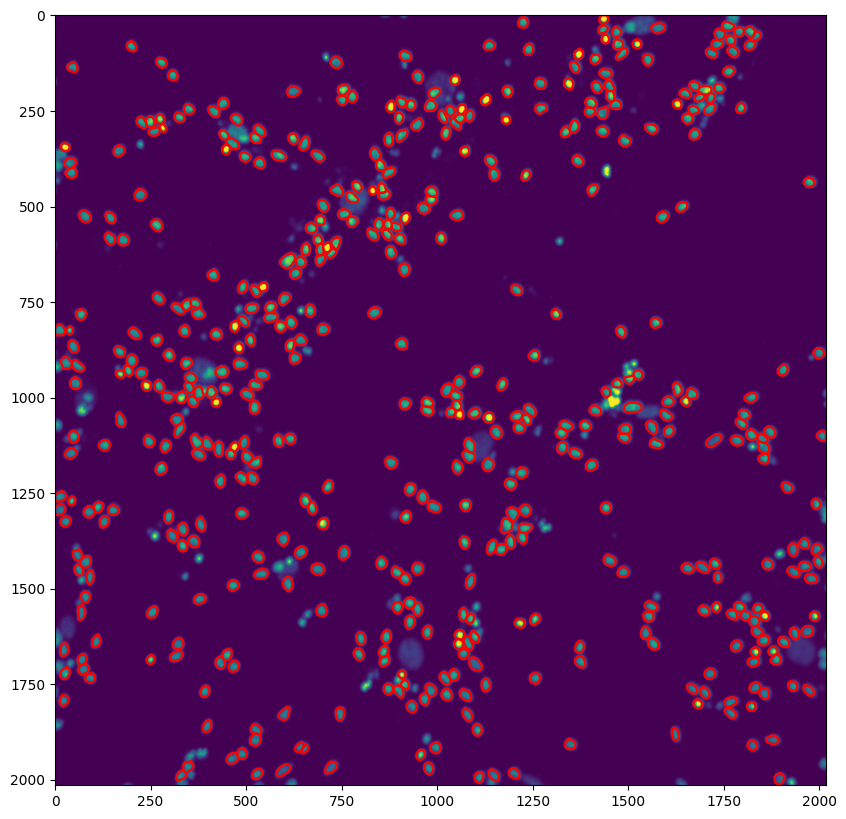

In [50]:
# Looking at Labels now

dat_lab_nuc_204 = np.load('Cov_1_Nuc_Cellpose/Label/F204_mc_test_seg.npy', allow_pickle=True).item()

# plot image with masks overlaid
mask_RGB = plot.mask_overlay(dat_lab_nuc_204['img'], dat_lab_nuc_204['masks'],
                        colors=np.array(dat_lab_nuc_204['colors']))

# plot image with outlines overlaid in red
outlines = utils.outlines_list(dat_lab_nuc_204['masks'])
plt.figure(figsize = (10,10))
plt.imshow(dat_lab_nuc_204['img'])
for o in outlines:
    plt.plot(o[:,0], o[:,1], color='r')

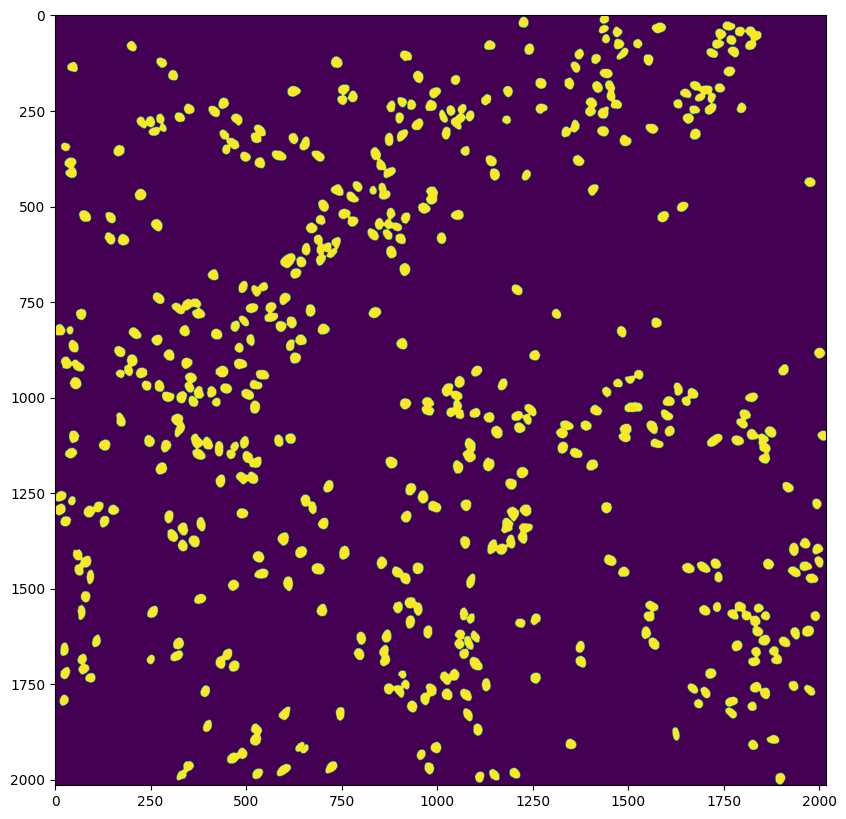

In [51]:
# This is just for calculating the F1 scores
mask_lab_nuc_204 = dat_lab_nuc_204['masks'] > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_lab_nuc_204)

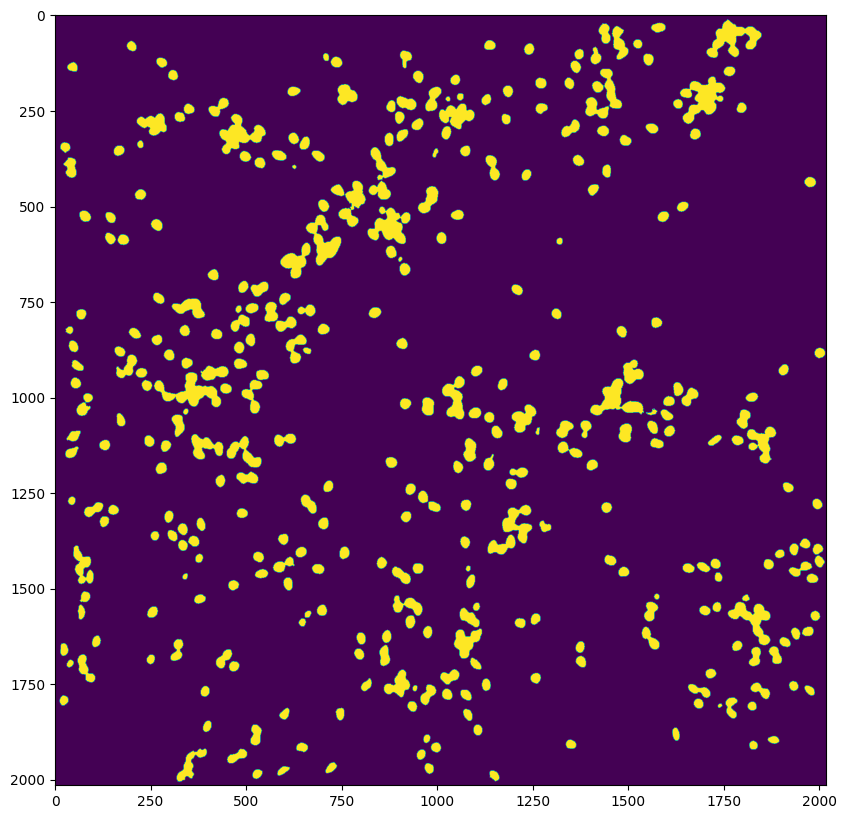

In [41]:
# Cell Profiler segmentation mask
cp_nuc_204 = imread("Cov_1_Nuc_Cellpose/cp/F204_max_clean_Nuclei.tiff")
mask_cp_nuc_204 = cp_nuc_204 > 0
plt.figure(figsize = (10,10))
plt.imshow(mask_cp_nuc_204)

In [52]:
print(f1_score(mask_test_nuc_204, mask_lab_nuc_204) ,f1_score(mask_cp_nuc_204, mask_lab_nuc_204) )

0.8637577341047101 0.8852998203531208


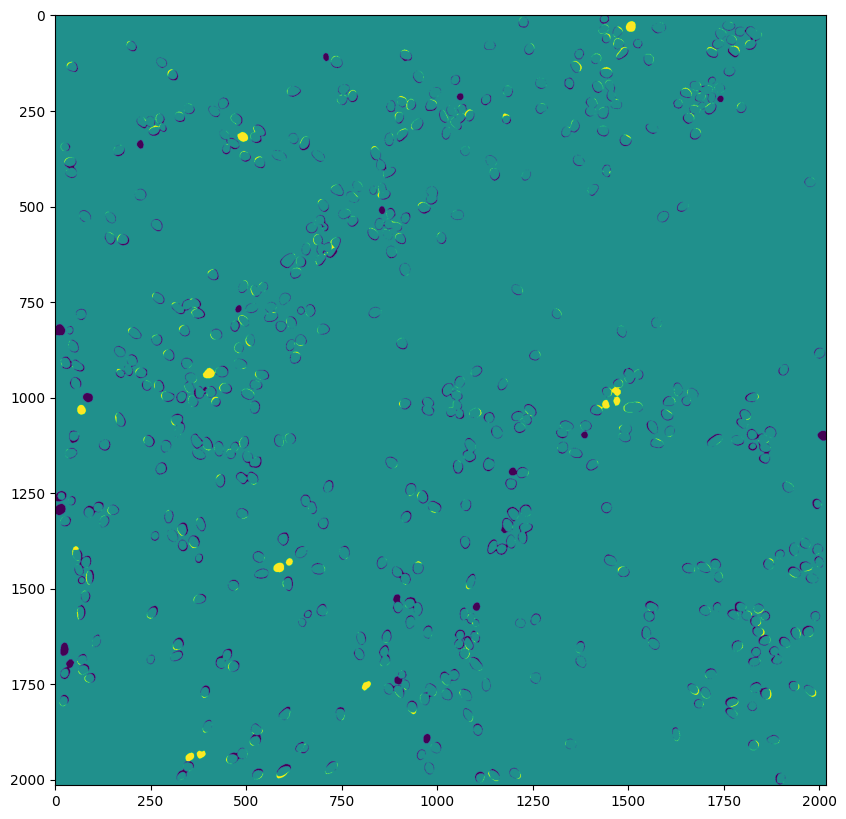

In [144]:
test_minus_lab = np.subtract(mask_test_nuc_204.astype(int) , mask_lab_nuc_204.astype(int))
plt.figure(figsize = (10,10))
plt.imshow(test_minus_lab)

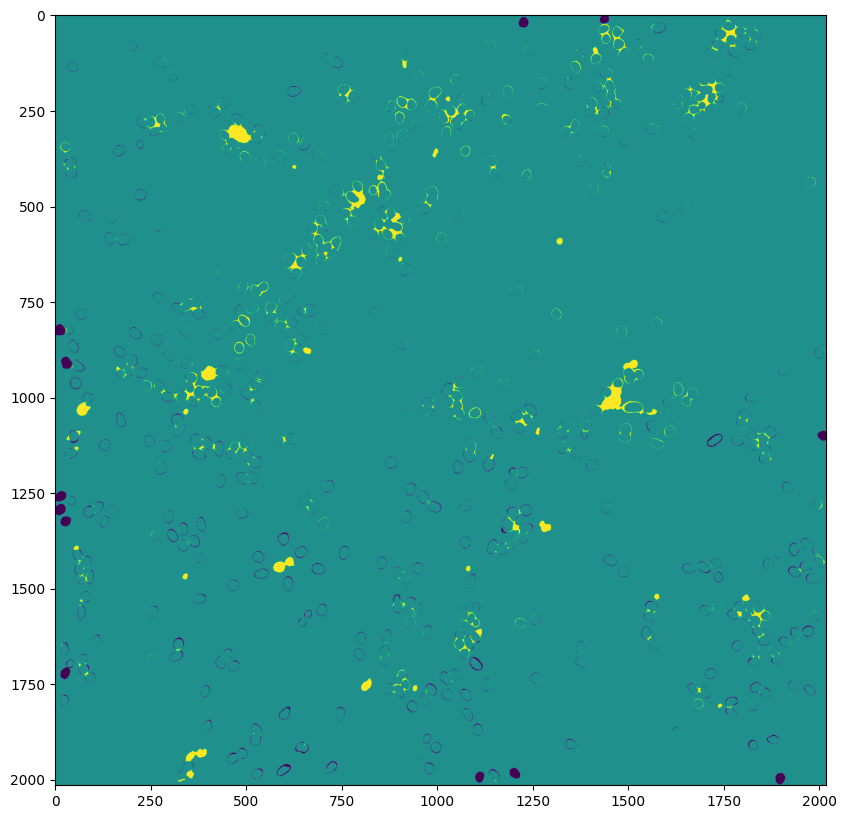

In [145]:
cp_minus_lab = np.subtract(mask_cp_nuc_204.astype(int) , mask_lab_nuc_204.astype(int))
plt.figure(figsize = (10,10))
plt.imshow(cp_minus_lab)